# Study case Quinten


## Introduction



Dans ce notebook on va traiter le probleme d'attrition des clients chez une banque en detail 

## Importer les bibliotheques necessaires

In [150]:
import math
import warnings
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import seaborn as sns
import shap
from catboost import CatBoostClassifier, CatBoostRegressor
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.metrics import sensitivity_score, specificity_score
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import balanced_accuracy_score, make_scorer, mean_squared_error, roc_auc_score,ConfusionMatrixDisplay
from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, RobustScaler, LabelEncoder
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBClassifier


import missingno as msno

import optuna
import pickle
# Pour éviter les avertissements lors de l'exécution
warnings.filterwarnings("ignore")


## Load Data 

In [2]:
data=pd.read_csv("dataset.csv",sep=";")

## Visualisation des données 

### Description des données

In [3]:
data.head()

,id_client,genre,espace_client_web,assurance_vie,banque_principale,anciennete_mois,compte_epargne,credit_autres,cartes_bancaires,compte_courant,...,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,branche,churn
0,3463,H,0.0,non,non,37.0,oui,consommation,medium,oui,...,13545.535937,12243.785415,12140.590245,9013.777747,11604.261036,16390.415593,14631.204899,23988.305931,NORD-OUEST,non
1,1869,H,0.0,oui,oui,72.0,oui,consommation,premium,inconnu,...,14014.989673,15508.546834,17547.988381,15470.524076,17537.628474,17410.472648,21258.908987,21554.411100,NORD-OUEST,non
2,3760,H,0.0,non,non,3.0,oui,NaN,medium,non,...,17239.846026,19479.322456,21343.802381,24084.291026,25823.493343,25839.829752,25587.814976,29736.376226,NORD-OUEST,non
3,3820,H,1.0,oui,non,72.0,oui,consommation,medium,oui,...,9229.470887,11935.244779,11014.748509,11791.353542,16354.051367,15449.967495,21149.789933,29211.314803,NORD-OUEST,non
4,1463,F,0.0,non,non,4.0,oui,permanent,medium,non,...,9008.641700,5875.342745,6101.742525,8026.508871,10361.246523,10575.966610,6714.625315,9101.978017,NORD-OUEST,oui


In [4]:
pd.set_option('display.max_rows', None)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 63 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id_client                     7043 non-null   int64  
 1   genre                         6915 non-null   object 
 2   espace_client_web             6916 non-null   float64
 3   assurance_vie                 6912 non-null   object 
 4   banque_principale             6921 non-null   object 
 5   anciennete_mois               6909 non-null   float64
 6   compte_epargne                6894 non-null   object 
 7   credit_autres                 6916 non-null   object 
 8   cartes_bancaires              6893 non-null   object 
 9   compte_courant                6896 non-null   object 
 10  compte_joint                  6912 non-null   object 
 11  PEA                           6897 non-null   object 
 12  assurance_auto                6907 non-null   object 
 13  ass

In [5]:
data.describe()

,id_client,espace_client_web,anciennete_mois,agios_6mois,age,var_0,var_1,var_2,var_3,var_4,...,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38
count,7043.000000,6916.000000,6909.000000,6896.000000,6889.000000,6893.000000,6905.000000,6885.000000,6896.000000,6905.000000,...,6899.000000,6887.000000,6891.000000,6896.000000,6909.000000,6901.000000,6912.000000,6908.000000,6895.000000,6888.000000
mean,3521.000000,0.162666,32.378926,64.761615,43.608506,7179.987046,9181.184842,11216.801336,13181.565491,15226.615127,...,9785.838628,11068.392722,12451.917950,13847.487586,15330.769094,16951.694375,18658.079824,20385.900574,22273.316999,24236.491341
std,2033.283305,0.369088,24.572971,30.101904,16.215077,5810.200728,6146.097003,6473.621085,6755.778274,7027.169215,...,5557.064049,6048.259593,6548.008325,7052.226589,7588.094743,8077.431652,8687.004053,9186.926461,9830.595029,10422.086601
min,0.000000,0.000000,0.000000,18.250000,20.000000,0.767658,-4241.785944,-3519.347763,-3913.768064,-5409.713059,...,-11.430930,31.496118,51.786562,258.614091,474.166678,1050.553067,1401.075175,1704.972375,1924.631757,2703.861155
25%,1760.500000,0.000000,9.000000,35.500000,31.000000,2711.797553,4684.731756,6636.687807,8445.162191,10366.064325,...,5863.700722,6822.771605,7808.787487,8856.463378,9925.688827,11192.255014,12495.574275,13819.139453,15285.970426,16756.046193
50%,3521.000000,0.000000,29.000000,70.325000,40.000000,5761.948333,7932.505258,10077.513755,12216.321177,14357.736653,...,8795.690408,9991.322358,11349.583083,12688.437278,14165.118676,15661.366988,17348.631325,19163.547474,20858.094755,22798.226057
75%,5281.500000,0.000000,55.000000,89.900000,54.000000,10136.583353,12472.797039,14815.834866,16987.139371,19319.195330,...,12498.175513,14106.366808,15778.954065,17538.748692,19411.026782,21410.796020,23378.954041,25524.326086,27639.687915,30000.951224
max,7042.000000,1.000000,72.000000,118.750000,121.000000,41438.097046,46912.076512,51594.948678,54555.922640,58810.829646,...,63031.464743,65002.617141,70562.371244,68887.212623,72692.134039,83405.277234,80492.250287,90443.667291,86499.286501,91176.277613


In [6]:
data.nunique().sort_values()

churn                              2
genre                              2
espace_client_web                  2
assurance_vie                      2
banque_principale                  2
type                               2
compte_epargne                     2
compte_titres                      2
credit_immo                        3
assurance_habitation               3
assurance_auto                     3
cartes_bancaires                   3
compte_joint                       3
compte_courant                     3
credit_autres                      3
PEA                                3
methode_contact                    4
branche                            6
segment_client                    15
anciennete_mois                   73
age                               88
agios_6mois                     1577
interet_compte_epargne_total    6411
var_18                          6870
var_15                          6882
var_2                           6885
var_30                          6887
v

### Supprimer les collonnes unecessaires

In [7]:
data=data.drop("id_client",axis=1)

#### Etude des variables manquantes

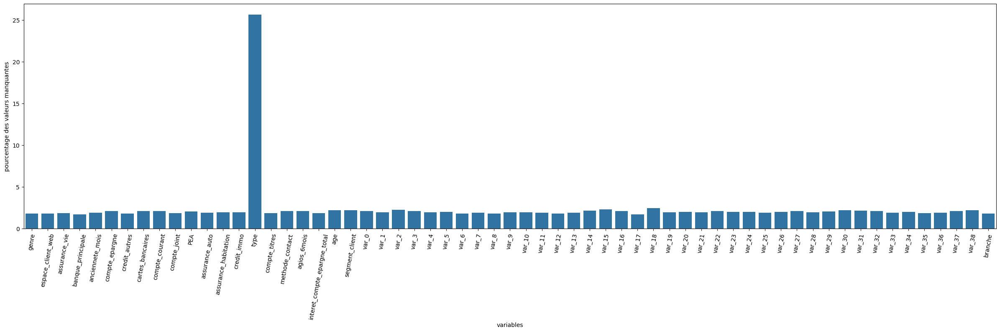

In [8]:
count_missing_values_percentage=(data.isna().sum()/len(data))*100
missing_values=count_missing_values_percentage[count_missing_values_percentage>0]
plt.figure(figsize=(30,7))
sns.barplot(x=missing_values.index,y=missing_values.values)
plt.xticks(rotation=80)
plt.xlabel("variables")
plt.ylabel("pourcentage des valeurs manquantes")
plt.show()

### Visualisation de la variable cible

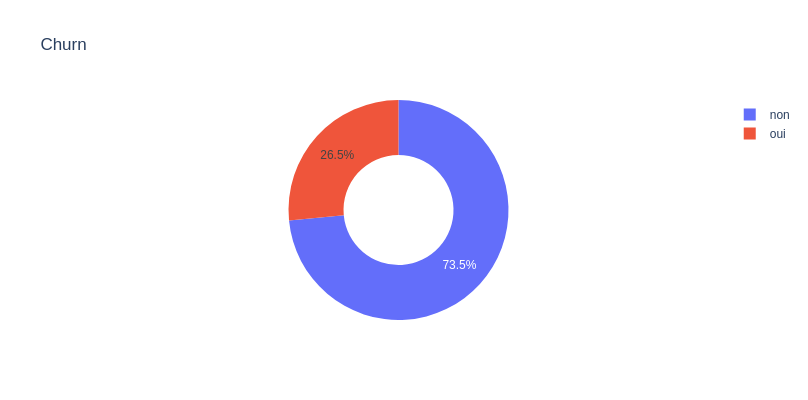

In [9]:
labels = data['churn'].unique()
values = data['churn'].value_counts()

fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.5)])
fig.update_layout(title_text="Churn",width=600, height=400)
fig.show()

### Modification de type de colonne interet compte epargne

In [10]:
data['interet_compte_epargne_total'] = data['interet_compte_epargne_total'].replace(" ",np.nan)
data['interet_compte_epargne_total'] = data['interet_compte_epargne_total'].astype("float64") 

### Visualisation des variables categorielles

In [11]:
object_columns = data.select_dtypes(include='object').columns
object_columns=object_columns.tolist()
object_columns.append("espace_client_web")

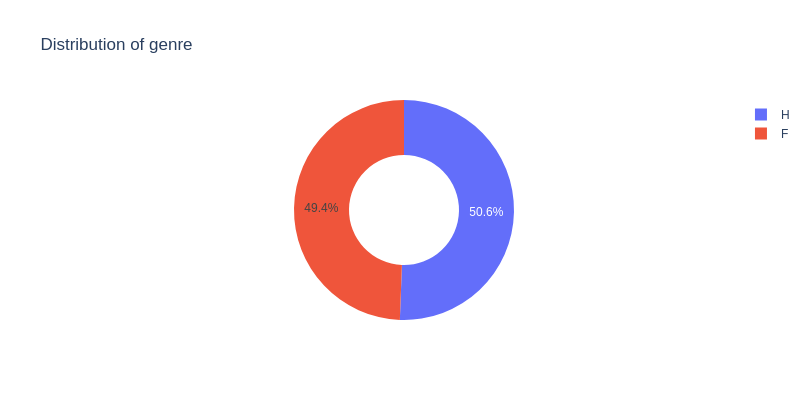

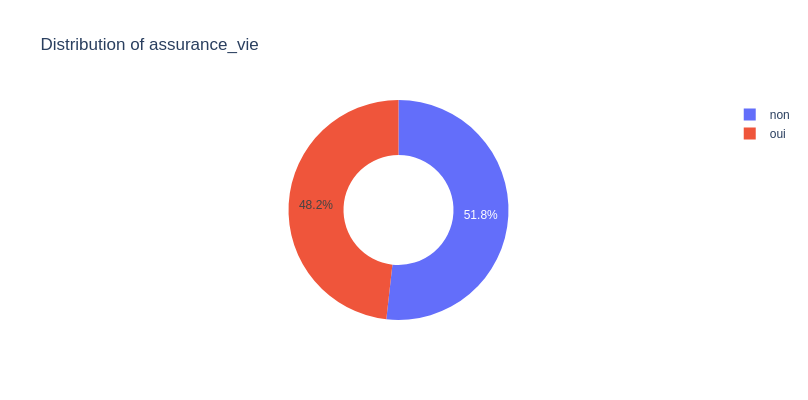

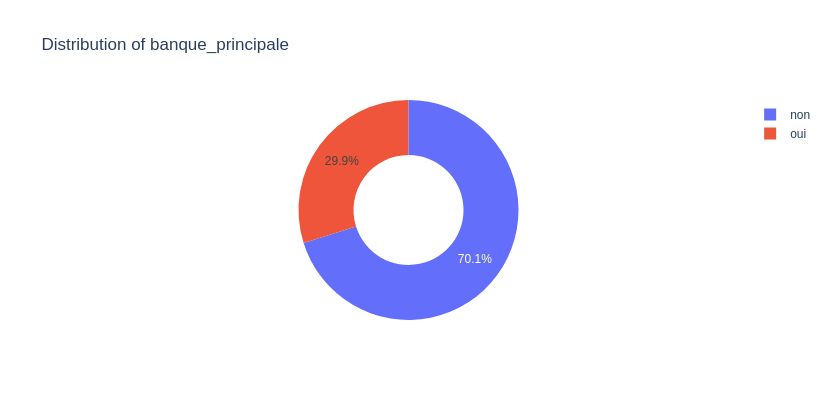

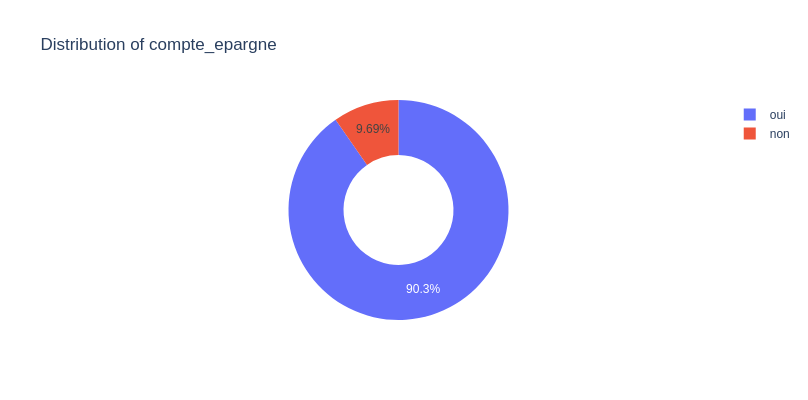

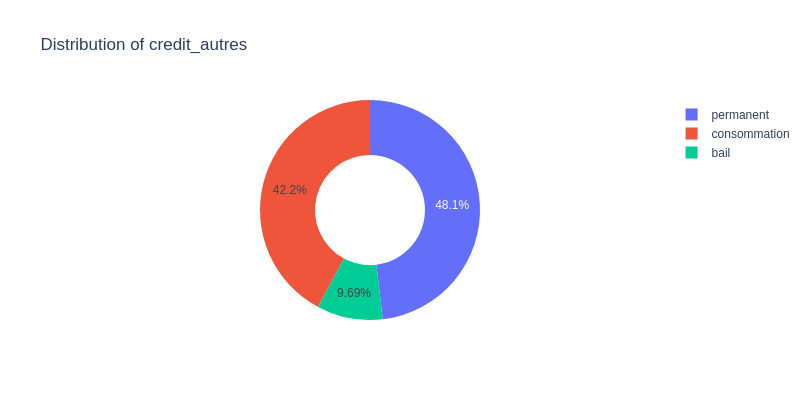

...

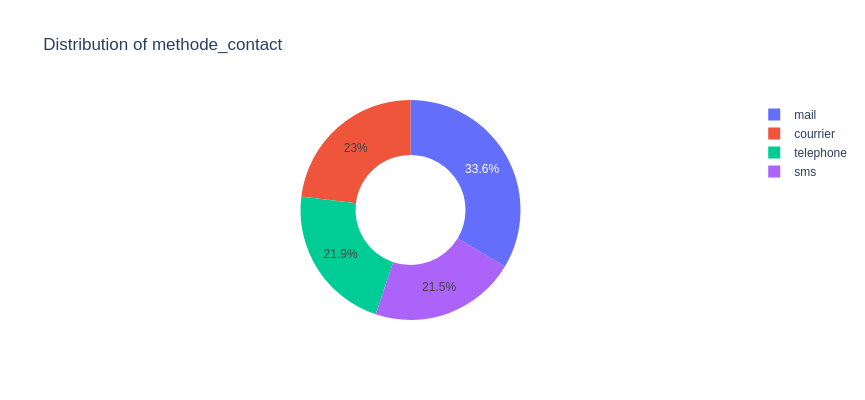

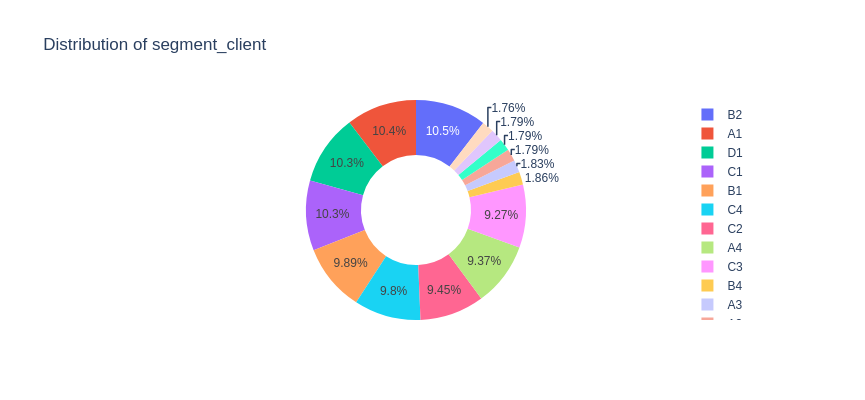

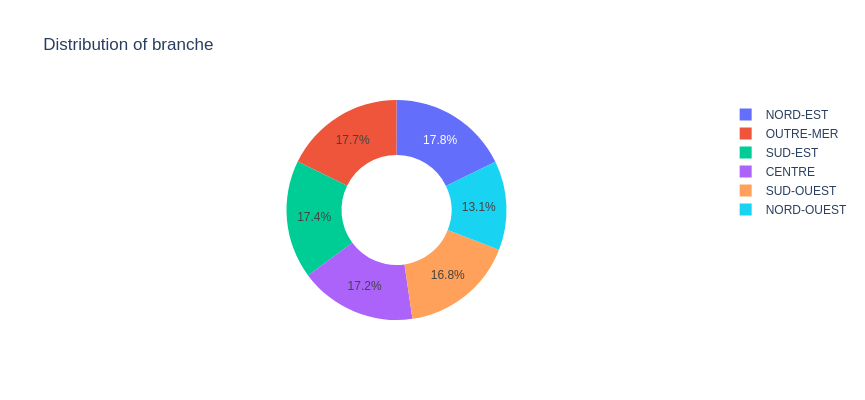

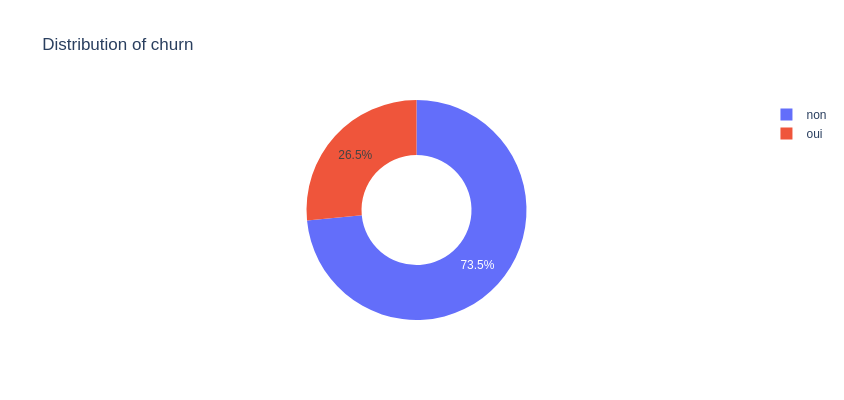

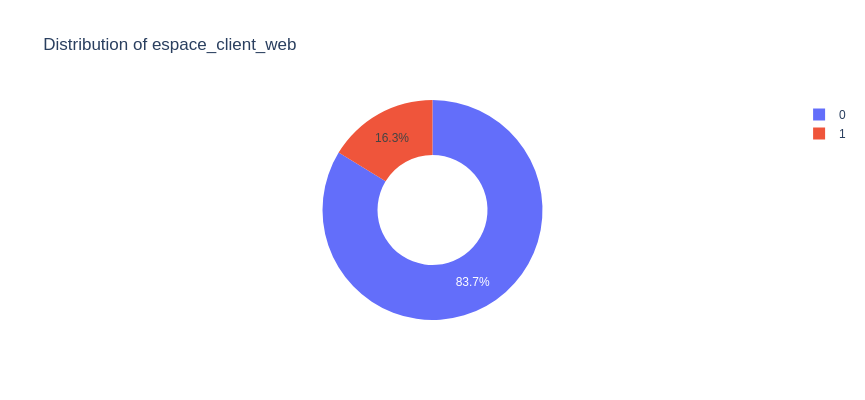

In [12]:
for i in object_columns:
    labels = data[i].value_counts().index
    values = data[i].value_counts()

    fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.5)])
    fig.update_layout(title_text=f"Distribution of {i}",width=600, height=400)
    fig.show()

### Visualisation des variables numeriques

In [13]:
continuous_var=data.select_dtypes(include="float").columns
continuous_var=continuous_var.tolist()
continuous_var.remove("espace_client_web")

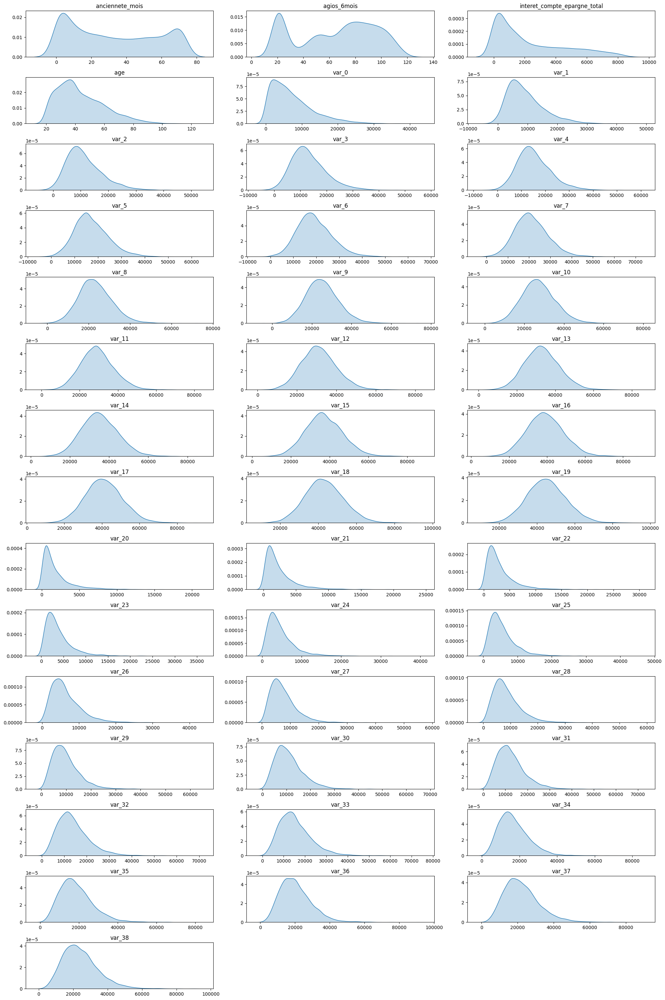

In [14]:
plt.figure(figsize=(20,30))
n_columns=3
n_rows=math.ceil(len(continuous_var)/n_columns)
for c,var in enumerate(continuous_var):
  plt.subplot(n_rows,n_columns,c+1)
  sns.kdeplot(data=data[continuous_var], x=var, fill=var)
  plt.title(str(var))
  plt.xlabel("")
  plt.ylabel("")

plt.tight_layout()

#### Detection des outliers pour les données numeriques

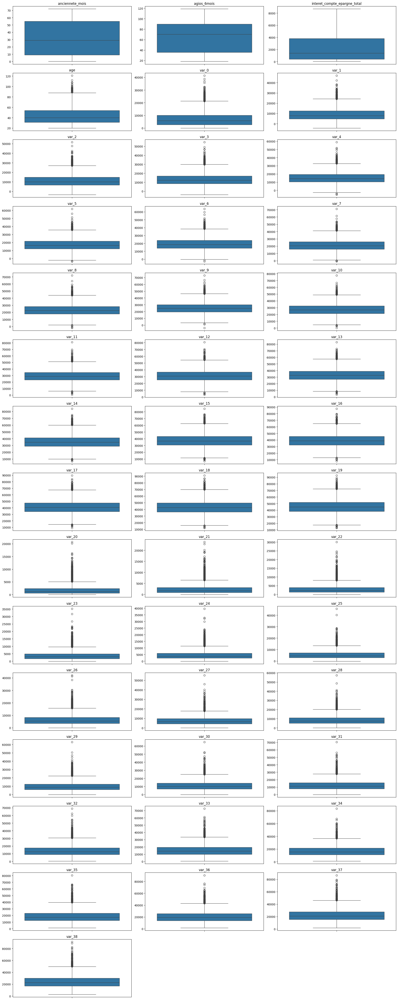

In [16]:
plt.figure(figsize=(20,50))
n_columns=3
n_rows=math.ceil(len(continuous_var)/n_columns)
for c,var in enumerate(continuous_var):
  plt.subplot(n_rows,n_columns,c+1)
  ax = sns.boxplot(data=data[continuous_var], y=var)
  ax.ticklabel_format(style='plain', axis='y')
  plt.title(str(var))
  plt.xlabel("")
  plt.ylabel("")

plt.tight_layout()

### Etude de correlation entre les variables

#### Etude de coorelation entre les variable numérique

<Axes: >

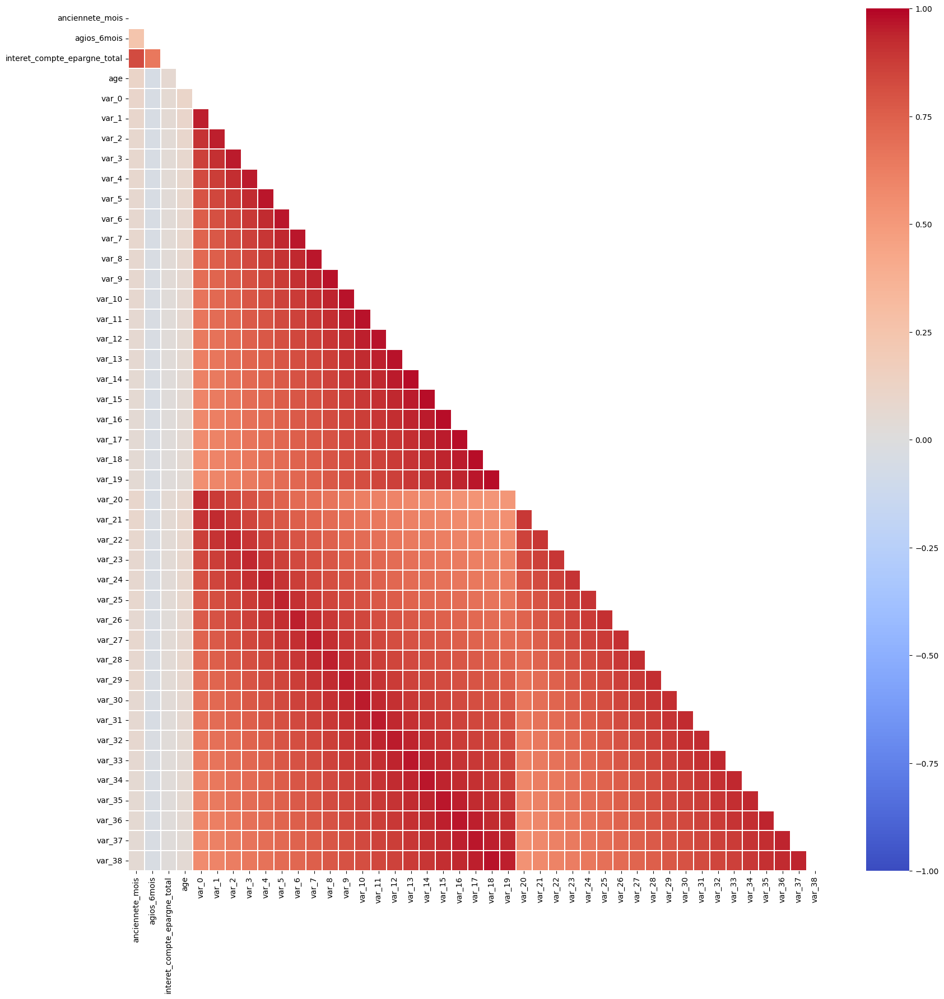

In [17]:
plt.figure(figsize=(20,20))
corelation_numerique=data[continuous_var].corr()
mask=np.triu(np.ones_like(corelation_numerique,dtype=bool))
sns.heatmap(corelation_numerique,mask=mask, xticklabels=continuous_var, yticklabels=continuous_var, annot=False, linewidths=.2, cmap='coolwarm', vmin=-1, vmax=1)

#### Etude de coorelation entre les variables categoriques

<Axes: >

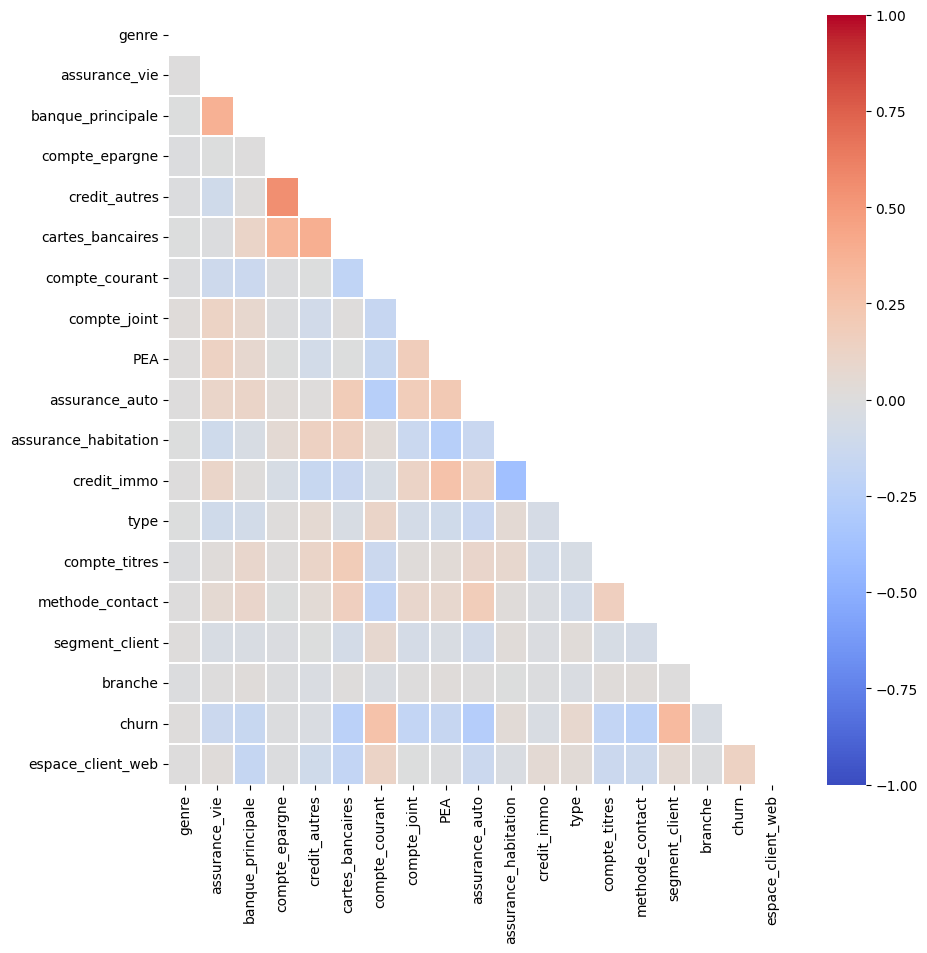

In [19]:
plt.figure(figsize=(10,10))
corr=data[object_columns].apply(lambda x:pd.factorize(x)[0]).corr()
mask=np.triu(np.ones_like(corr,dtype=bool))
sns.heatmap(corr,mask=mask, xticklabels=corr.columns, yticklabels=corr.columns, annot=False, linewidths=.2, cmap='coolwarm', vmin=-1, vmax=1)

#### Etude de coorelation entre la varaible cible et les autres variables

#### Etude de coorelation entre les variables categoriques et la varaiable cible

In [20]:
display(corr["churn"].sort_values(ascending=False))

churn                   1.000000
segment_client          0.319795
compte_courant          0.259301
espace_client_web       0.136179
type                    0.082557
assurance_habitation    0.031387
genre                   0.009311
compte_epargne         -0.013275
credit_autres          -0.027439
credit_immo            -0.036960
branche                -0.046156
assurance_vie          -0.130665
banque_principale      -0.149498
PEA                    -0.160015
compte_titres          -0.181943
compte_joint           -0.182033
methode_contact        -0.226160
cartes_bancaires       -0.227399
assurance_auto         -0.266703
Name: churn, dtype: float64

In [21]:
df=data
df['churn_num'] = data['churn'].map({'oui': 1, 'non': 0})

continous_var_df=continuous_var+["churn_num"]

# Calcul de la matrice de corrélation
corr_matrix_churn = df[continous_var_df].corr()['churn_num'].sort_values(ascending=False)

# Affichage de la corrélation entre 'churn' et les autres variables numériques
corr_matrix_churn.drop('churn_num', inplace=True)  # Retirer la corrélation de 'churn' avec lui-même
corr_matrix_churn

agios_6mois                     0.194814
var_19                         -0.154372
var_18                         -0.156179
var_37                         -0.157470
var_38                         -0.157721
var_17                         -0.159151
var_16                         -0.162443
var_36                         -0.163025
var_14                         -0.168932
var_15                         -0.169758
var_34                         -0.171175
var_35                         -0.172625
var_33                         -0.173686
var_13                         -0.175662
var_32                         -0.179820
var_11                         -0.181446
var_31                         -0.181692
var_12                         -0.184484
var_10                         -0.189710
var_30                         -0.189833
var_9                          -0.194267
var_29                         -0.197917
var_26                         -0.198237
interet_compte_epargne_total   -0.201026
var_27          

In [22]:
data=data.drop("churn_num",axis=1)

#### Etude des interactions entre les variables et le variable cible

#### Etude des interactions entre les variables continues et la variable churn

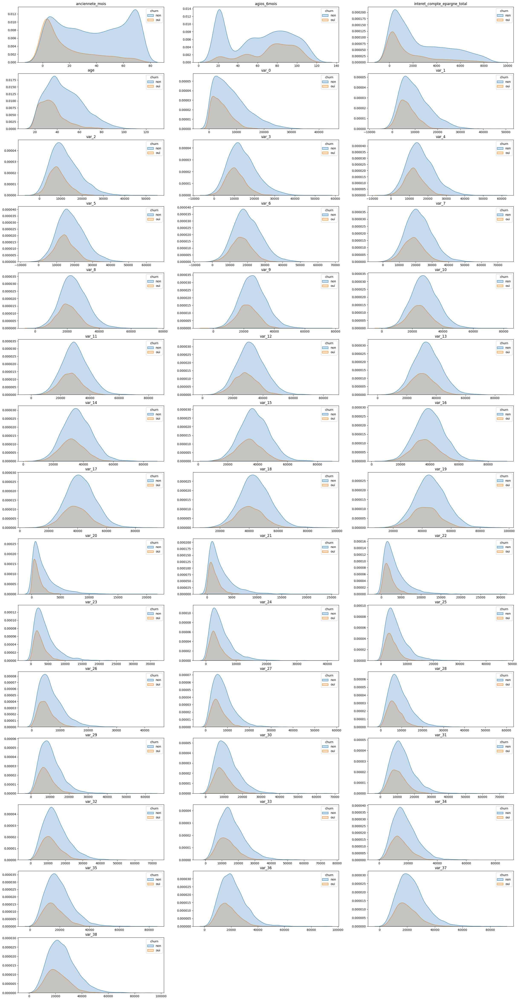

In [23]:
nums_columns=3
num_rows=math.ceil(len(continuous_var)/nums_columns)
plt.figure(figsize=(30,60))
for i,c in enumerate(continuous_var):
    plt.subplot(num_rows,nums_columns,i+1)
    ax=sns.kdeplot(data=data,x=c,hue="churn",shade=True)
    ax.ticklabel_format(style='plain', axis='y')
    plt.title(str(c))
    plt.xlabel("")
    plt.ylabel("")

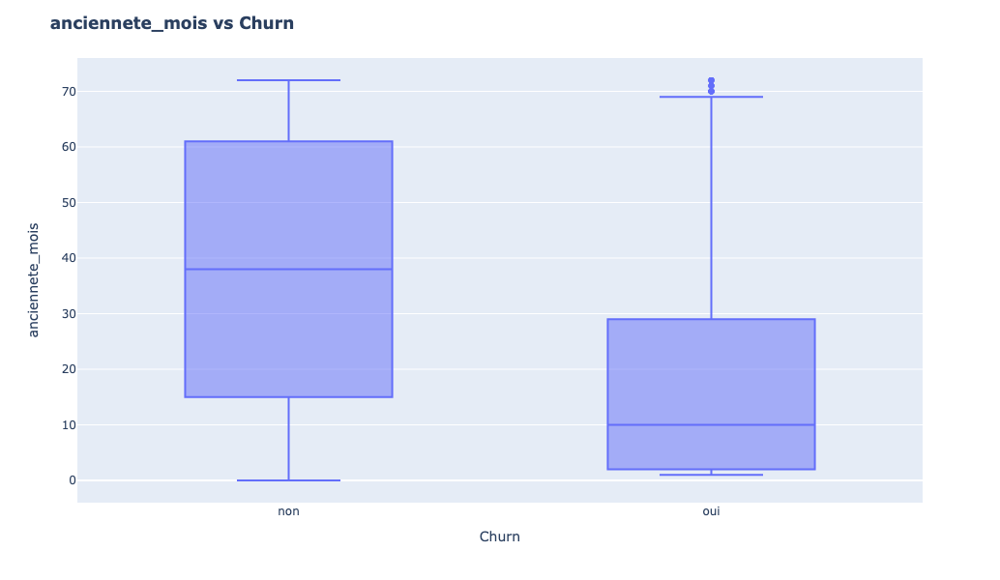

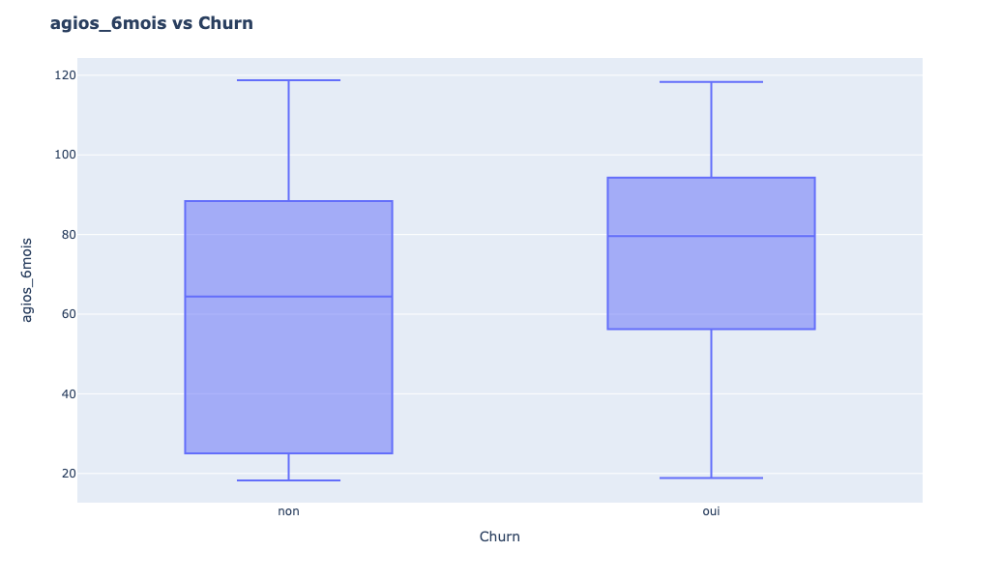

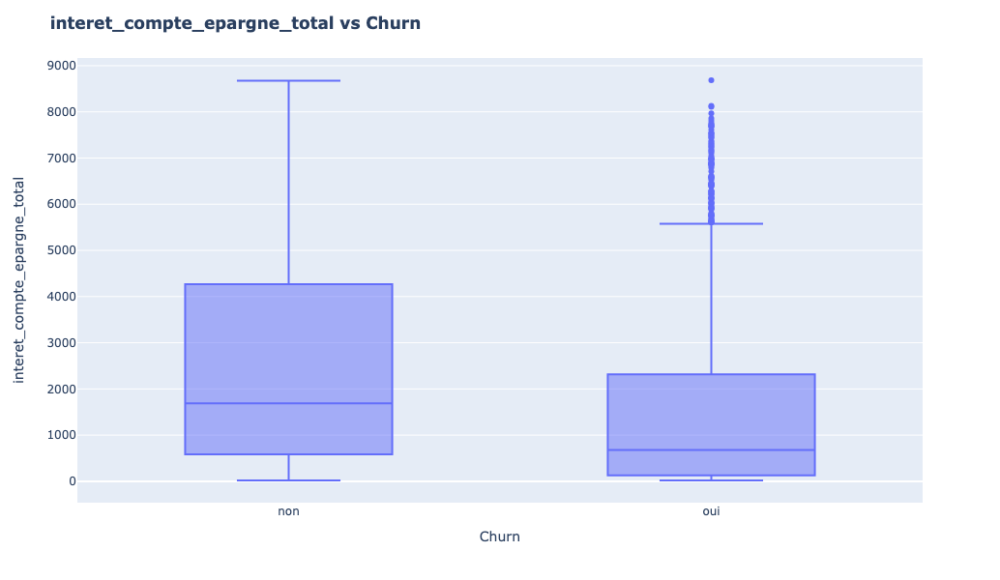

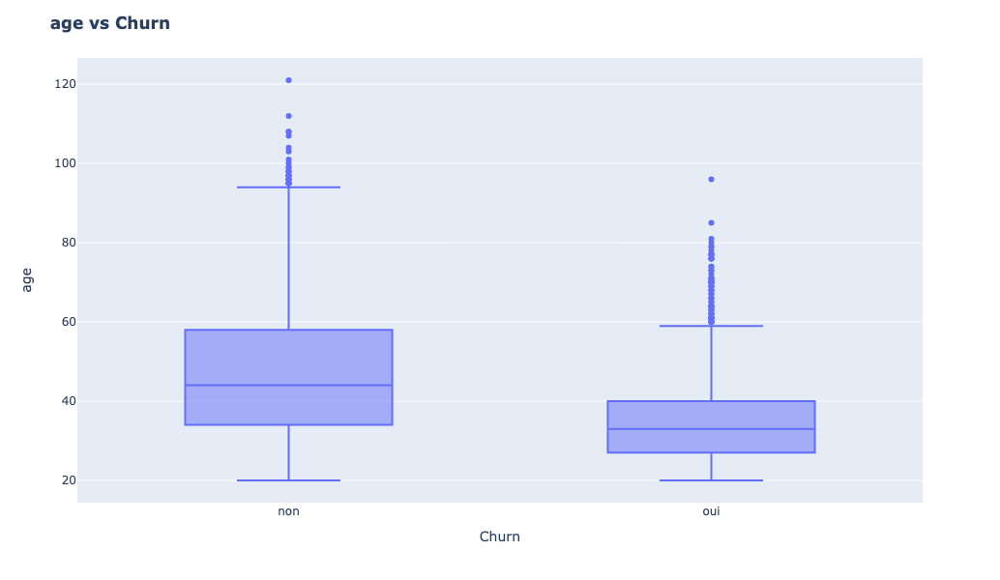

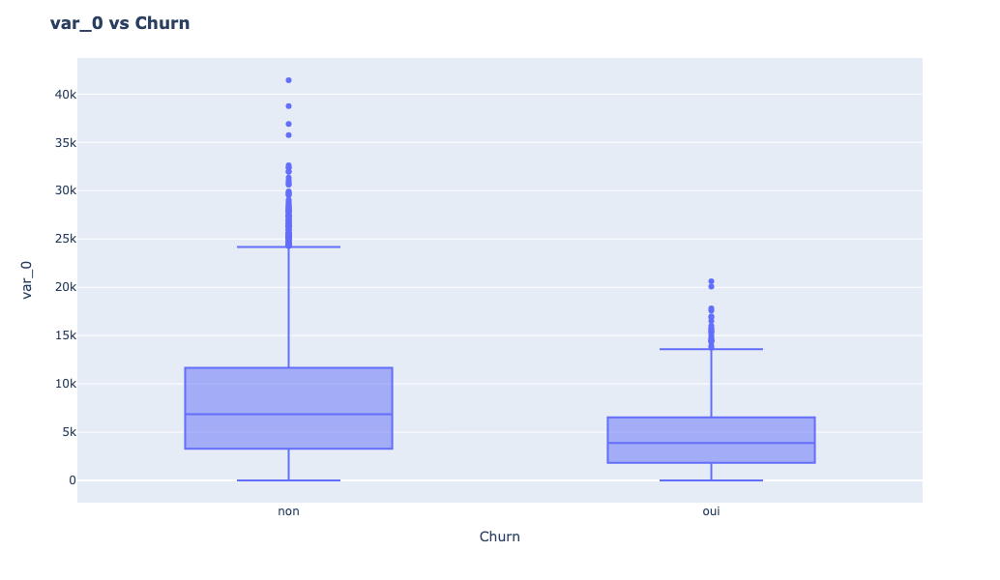

...

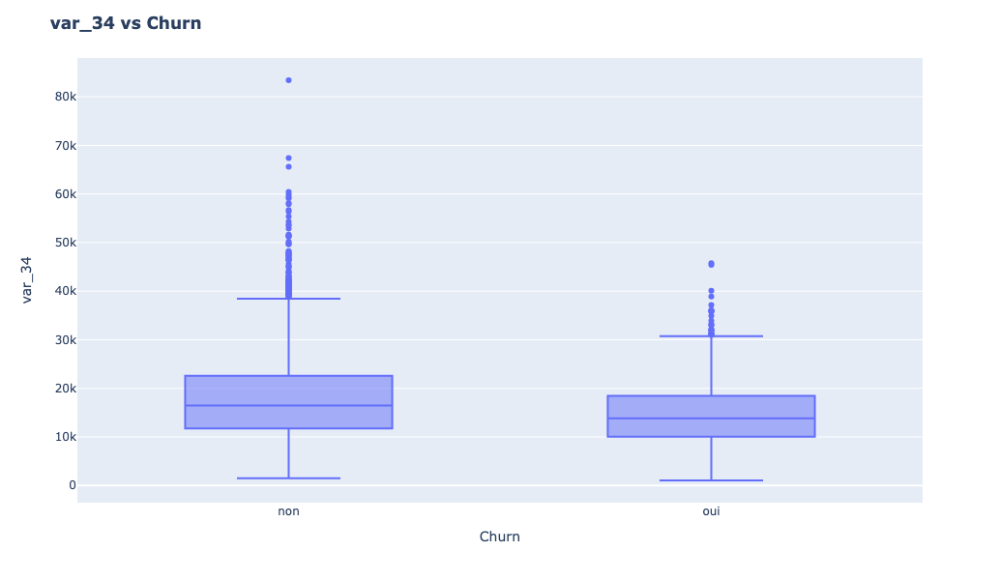

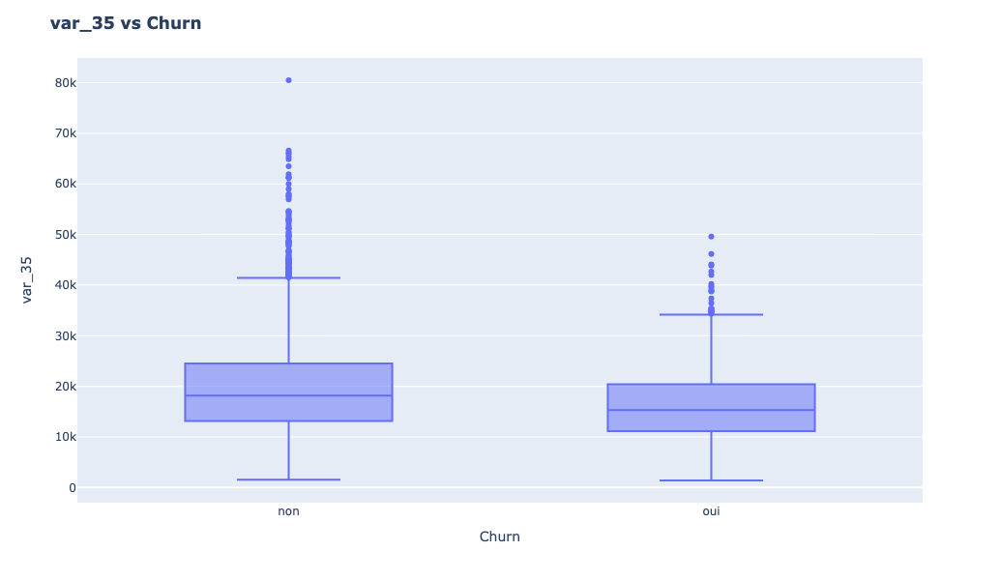

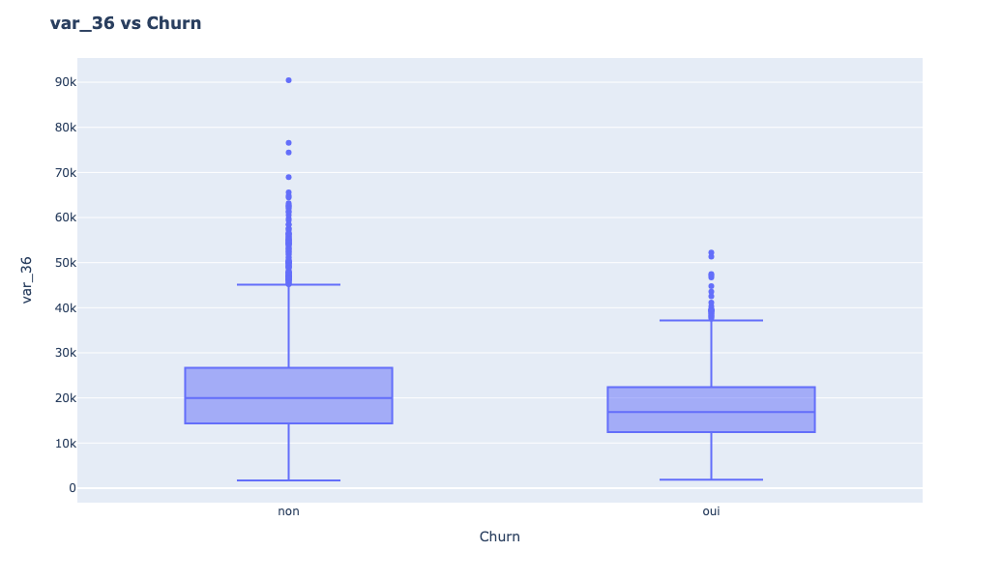

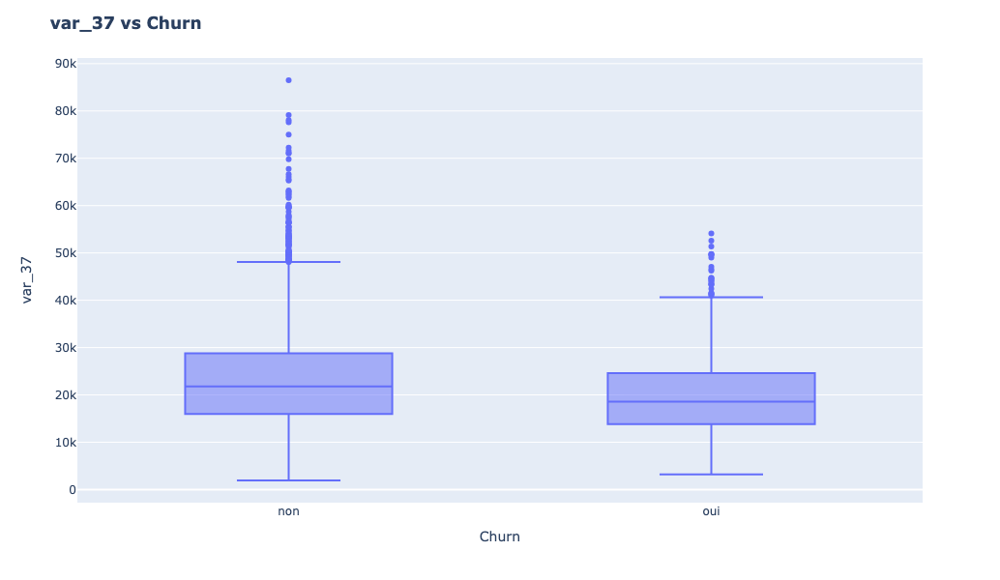

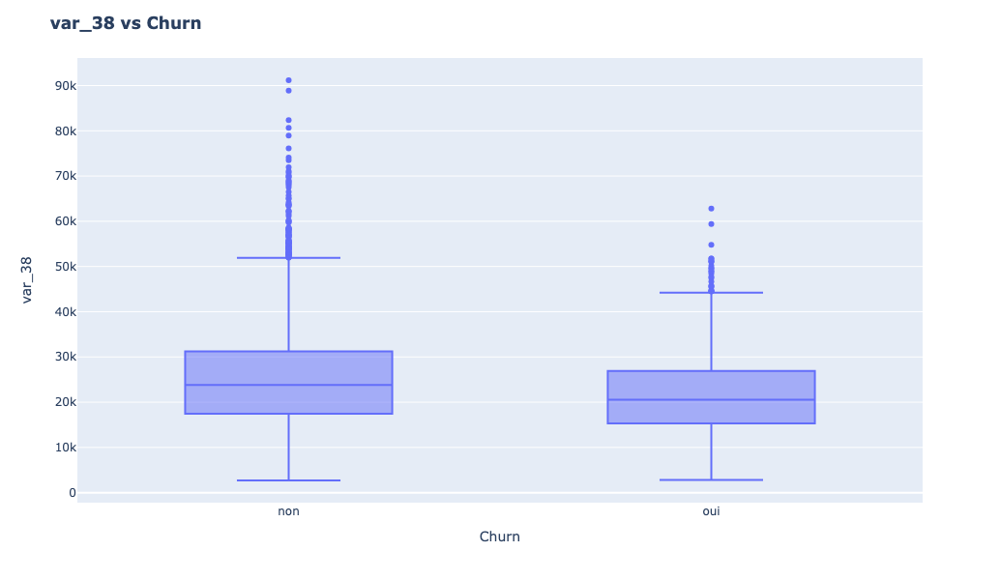

In [24]:
for i in continuous_var:
    fig = px.box(data, x='churn', y =i)
    
    # Update yaxis properties
    fig.update_yaxes(title_text=f'{i}', row=1, col=1)
    # Update xaxis properties
    fig.update_xaxes(title_text='Churn', row=1, col=1)
    
    # Update size and title
    fig.update_layout(autosize=True, width=750, height=600,
        title_font=dict(size=25, family='Courier'),
        title=f'<b>{i} vs Churn</b>',
    )
    
    fig.show()

#### Etude des correlations entre les varaibles categoriques et les variables 

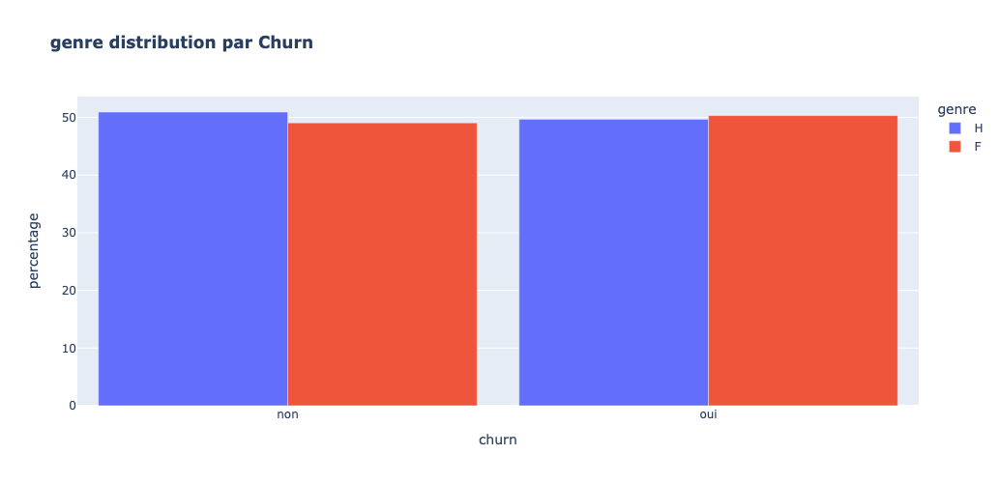

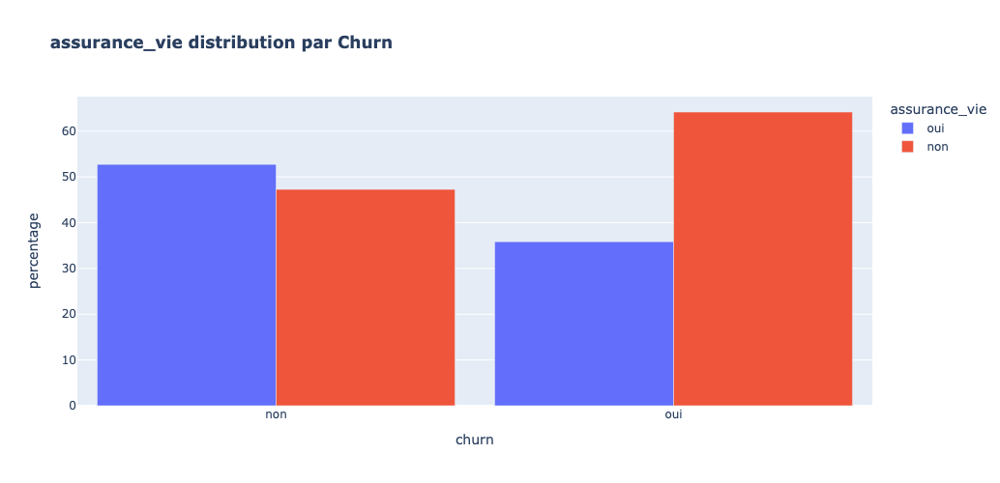

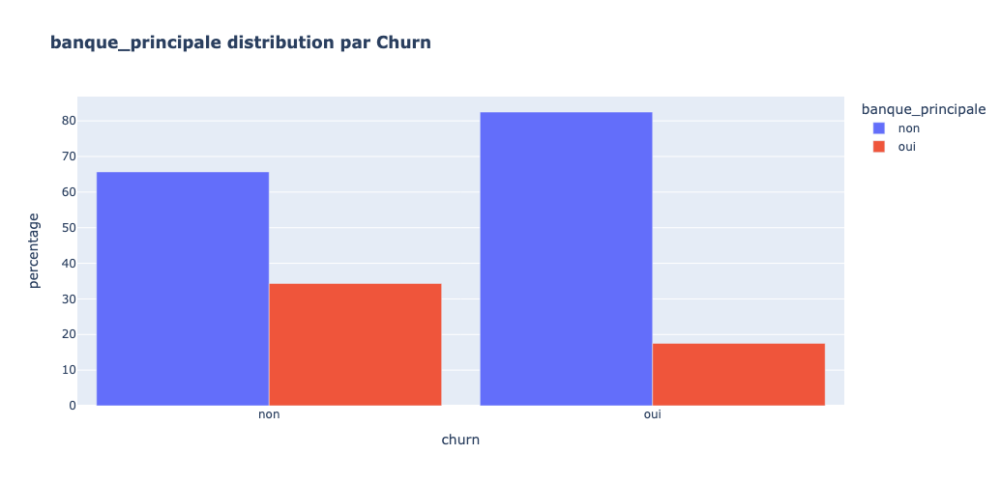

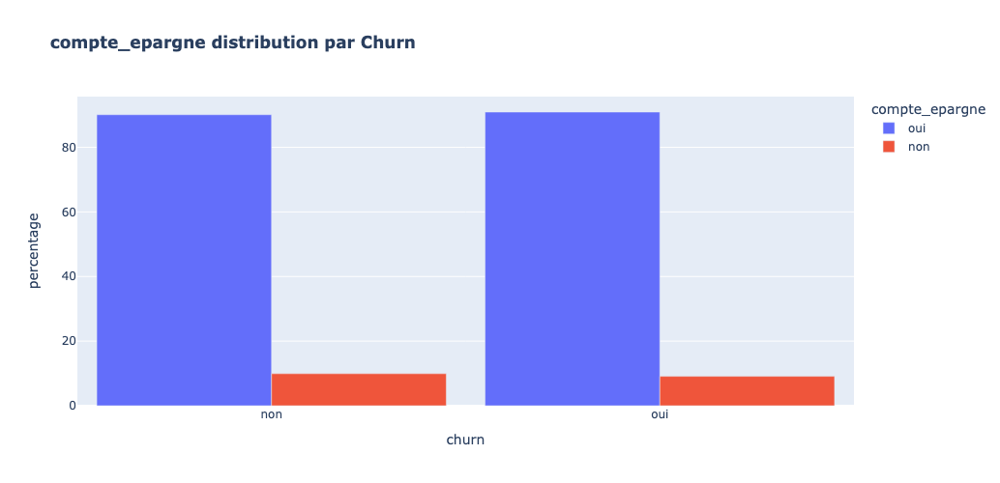

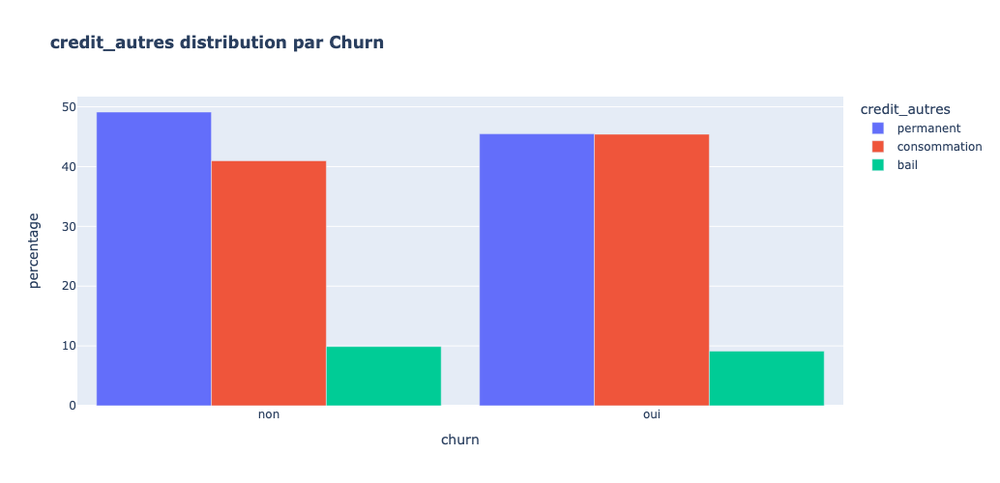

...

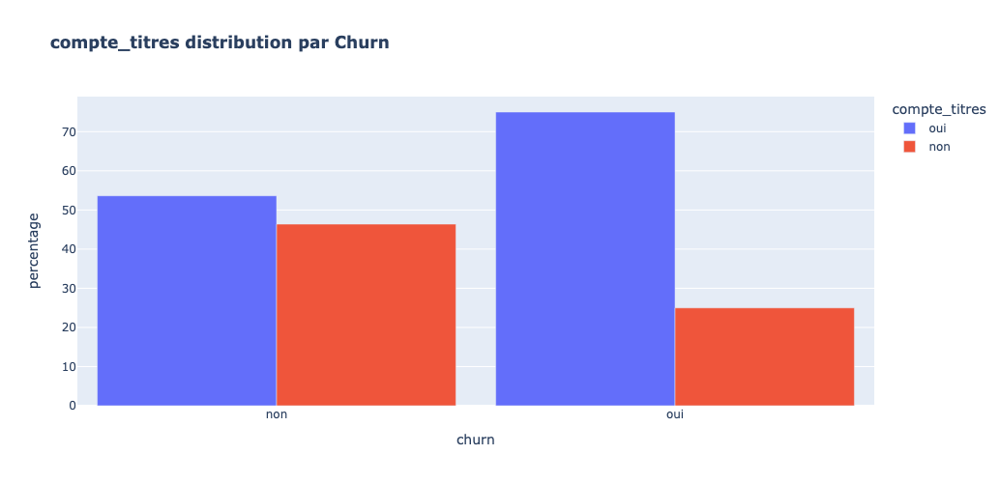

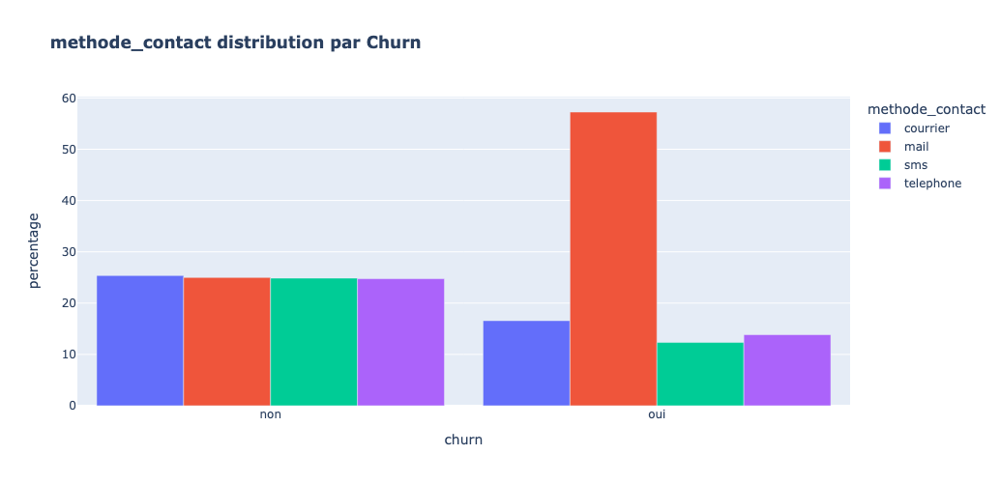

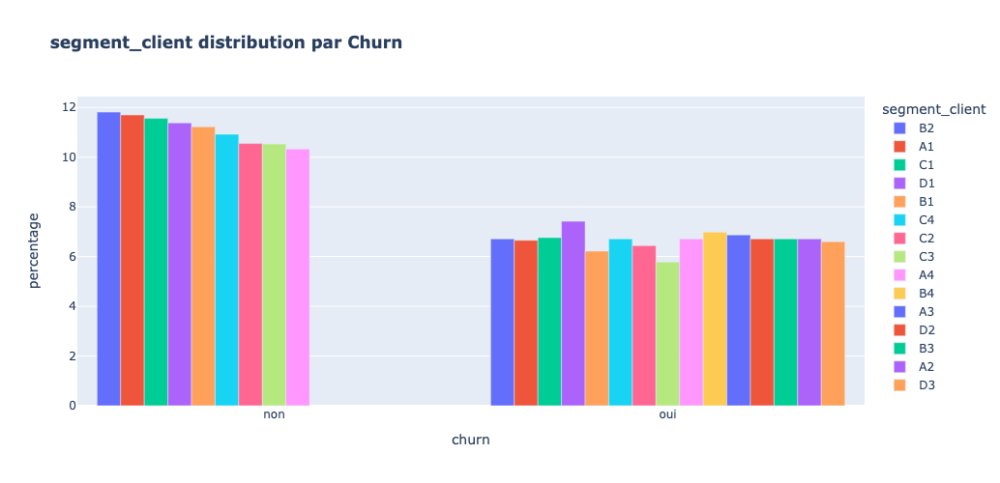

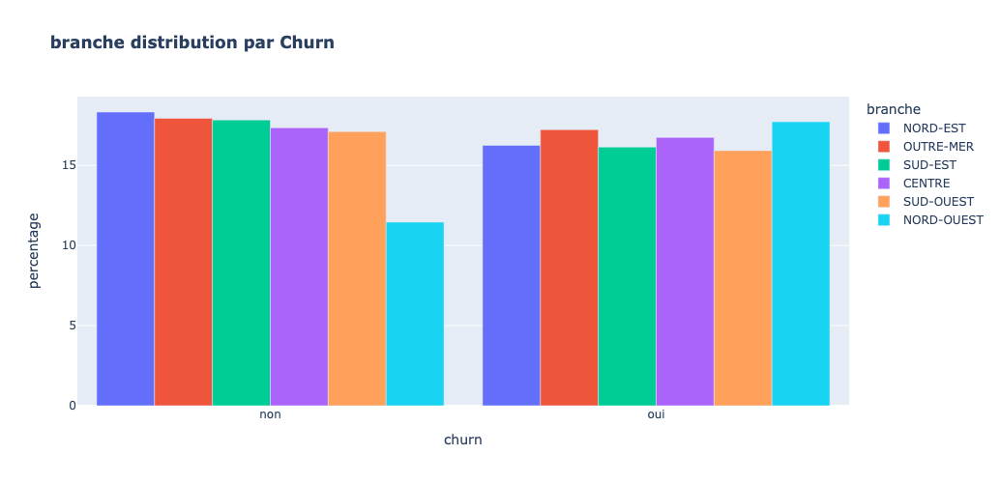

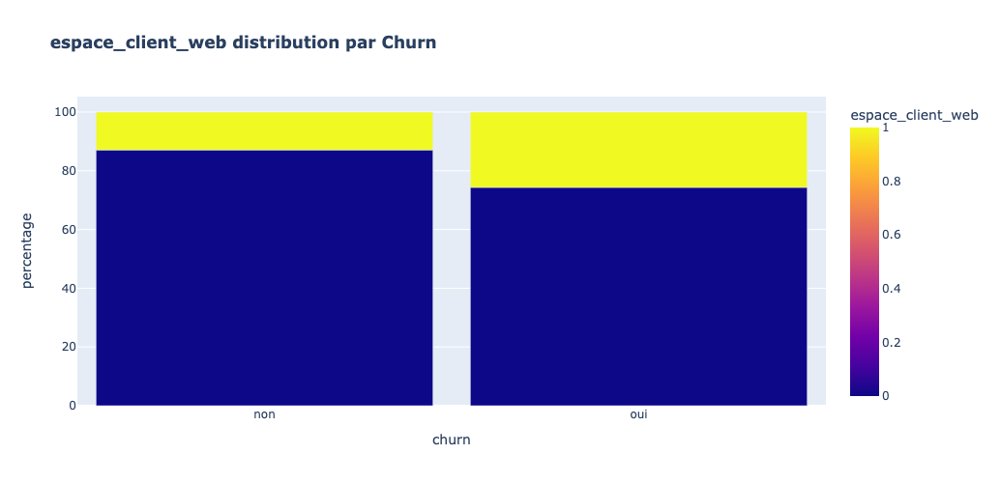

In [25]:
for i in object_columns:
    if i!="churn":
        
    # Calculer le pourcentage
        df_grouped = data.groupby("churn")[i].value_counts(normalize=True).rename('percentage').reset_index()
        df_grouped['percentage'] *= 100

    # Créer l'histogramme
        fig = px.bar(df_grouped, x="churn", y='percentage', color=i, barmode='group', title=f"<b>{i} distribution par Churn</b>")
        fig.update_layout(width=700, height=500, bargap=0.1)
        fig.show()

##### Visualisation de churn en fonction de segment client 

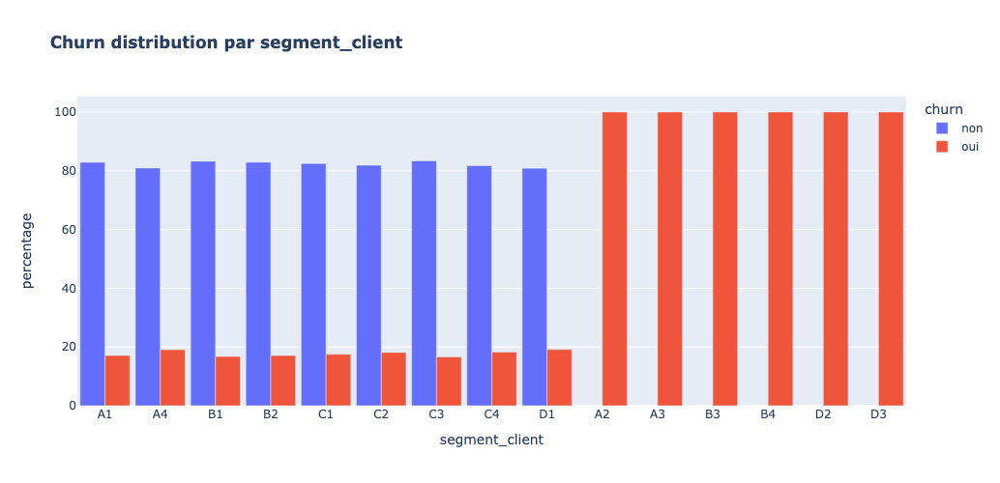

In [26]:
# Calculer le pourcentage
df_grouped = data.groupby("segment_client")["churn"].value_counts(normalize=True).rename('percentage').reset_index()
df_grouped['percentage'] *= 100

# Créer l'histogramme
fig = px.bar(df_grouped, x="segment_client", y='percentage', color="churn", barmode='group', title=f"<b>Churn distribution par segment_client</b>")
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

## Manupulation des données 

### Visualisation des données manquantes en fonction de churn


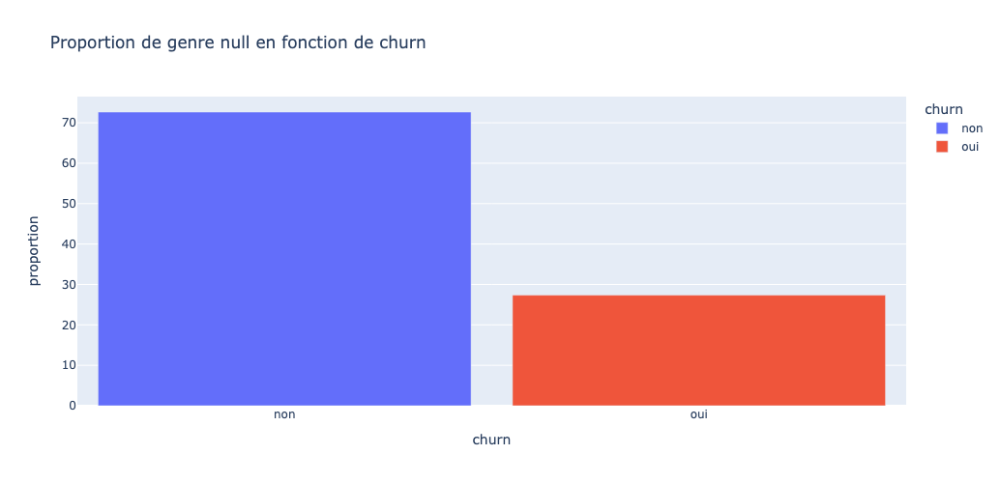

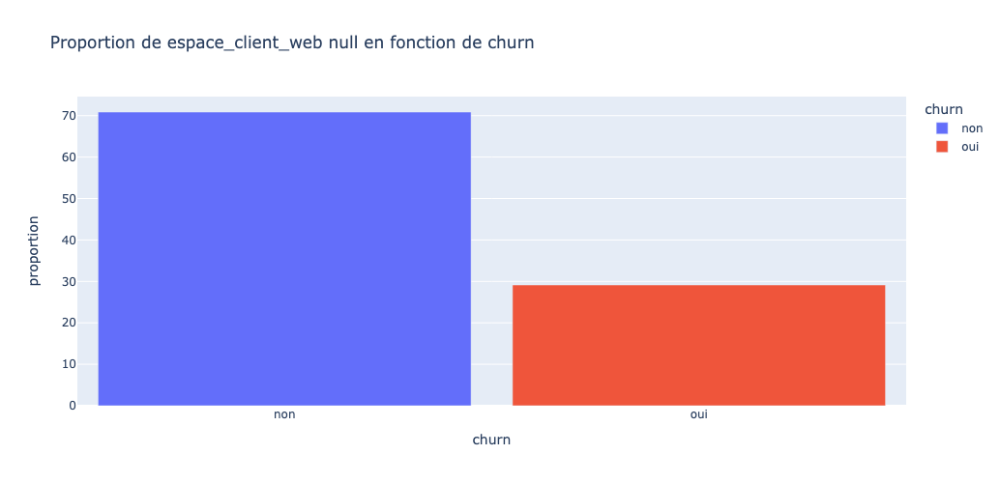

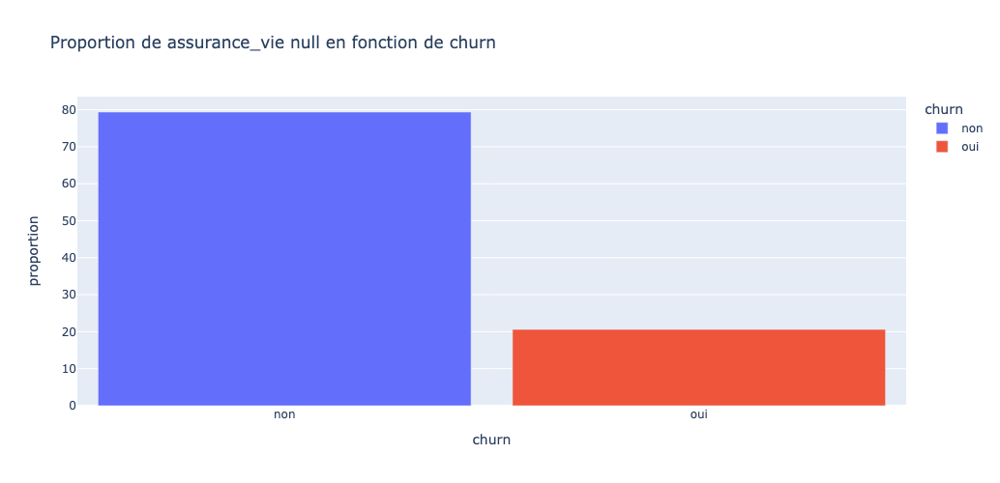

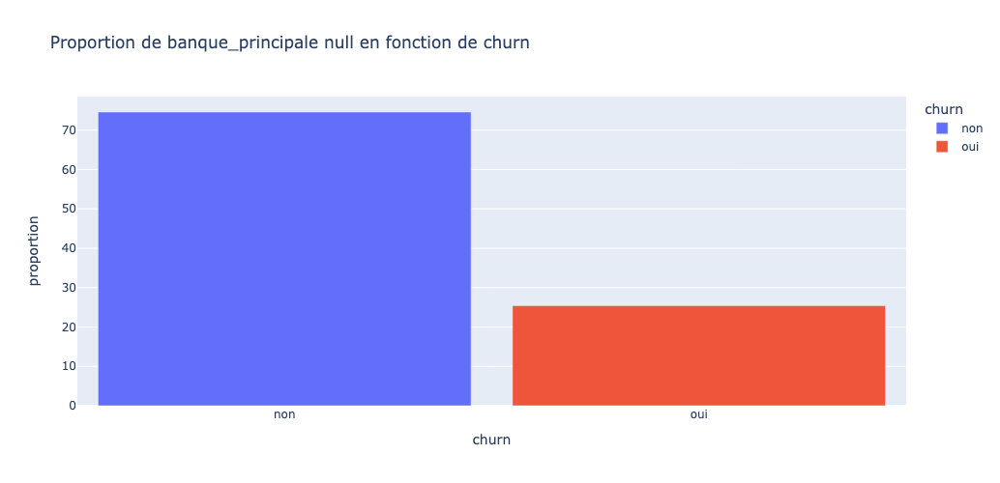

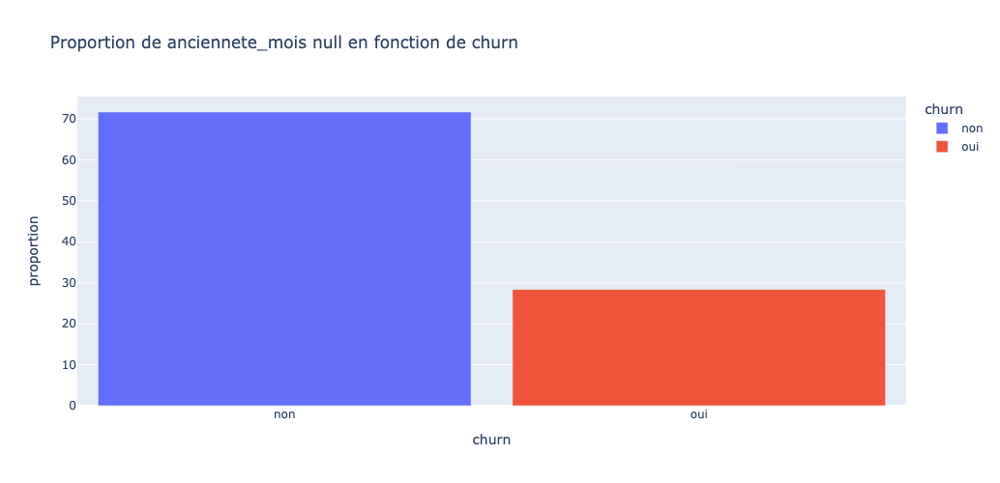

...

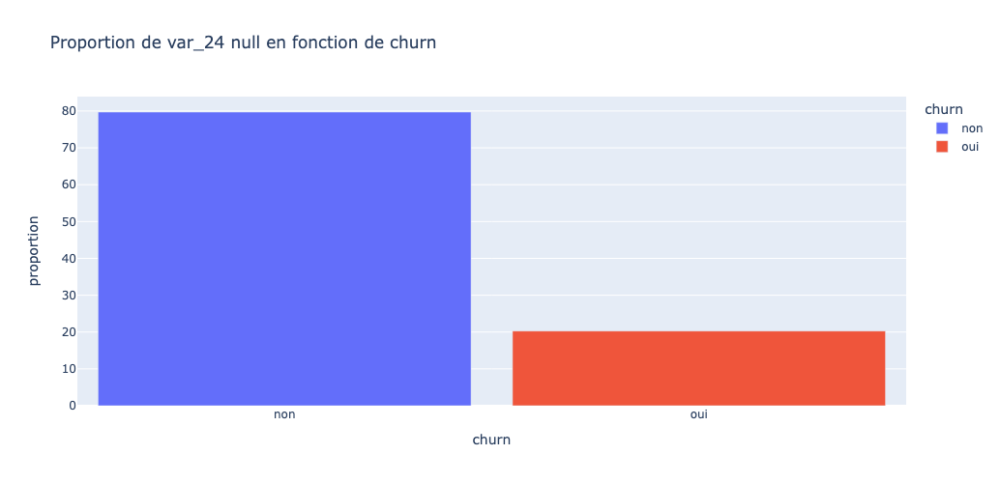

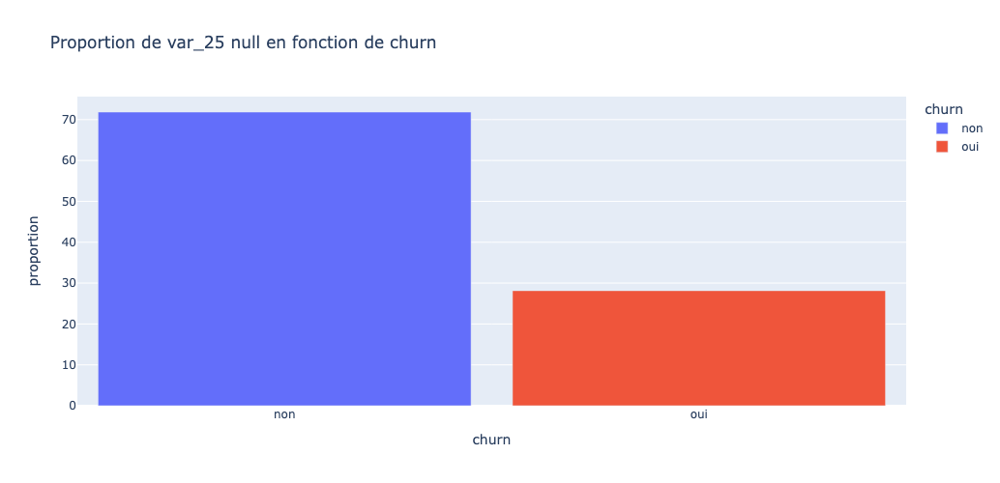

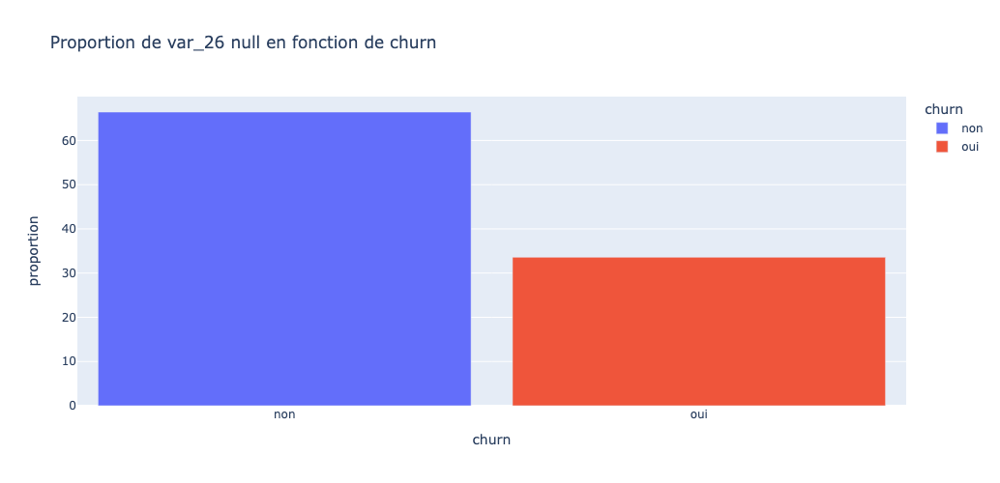

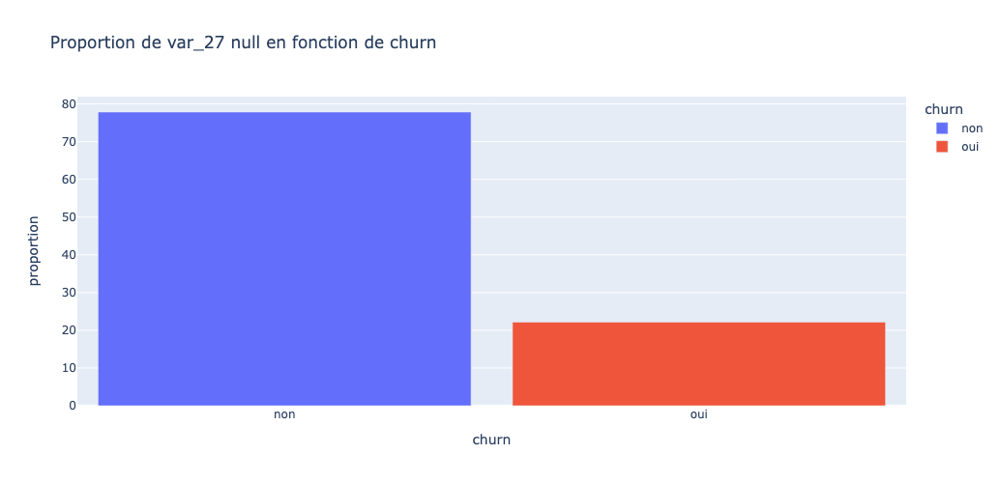

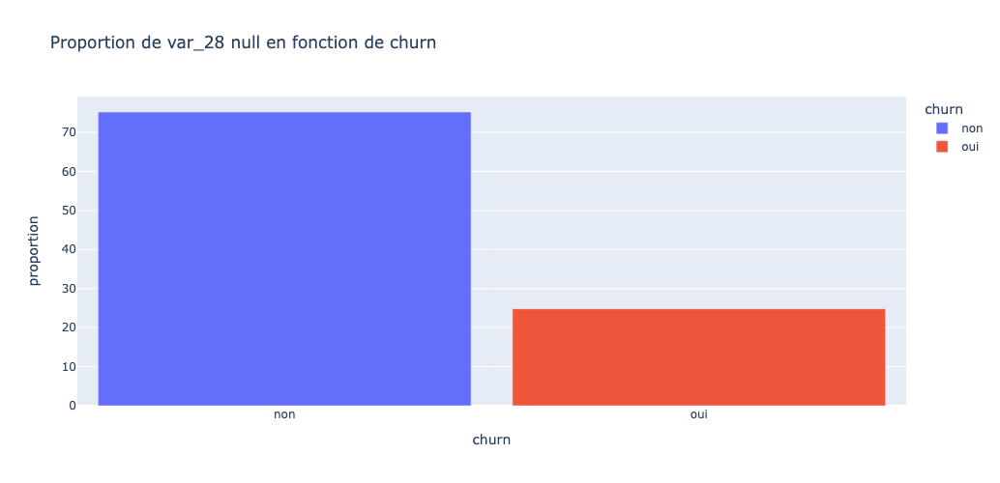

In [27]:
missing_values=data.isna().sum()
columns_with_missing_values=missing_values[missing_values>0].index.tolist()
for i in columns_with_missing_values:
    df_null_type=data[data[i].isna()]["churn"].value_counts(normalize=True).rename("proportion").reset_index()
    df_null_type["proportion"]=df_null_type["proportion"]*100
    fig=px.bar(df_null_type,x="churn",color="churn",y="proportion",title=f"Proportion de {i} null en fonction de churn")
    fig.update_layout(width=700, height=500, bargap=0.1)
    fig.show()

### Ajout des valeurs Manquantes Pour les variables ayant comme une categorie inconnu

Dans cette approche on va ajouter pour les varaibles manquantes et les varaibales ayant comme categorie inconnue on va ajiouter les Nan a cette categorie , et puisque on a visualisé que la distribution de varaible en fonction de churn et presque la meme que la distribution initiale d'ou cette ajout ne va pas affecter notre modéle .

In [28]:
list_column_inco=[]
for i in object_columns:
    if "inconnu" in data[i].unique():
        list_column_inco.append(i)

In [29]:
for i in list_column_inco:
    data[i]=data[i].fillna("inconnu")

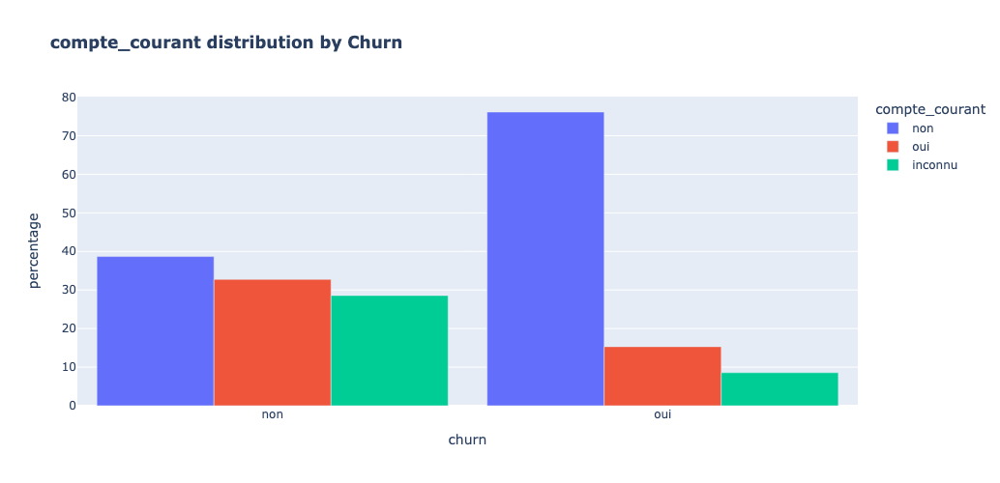

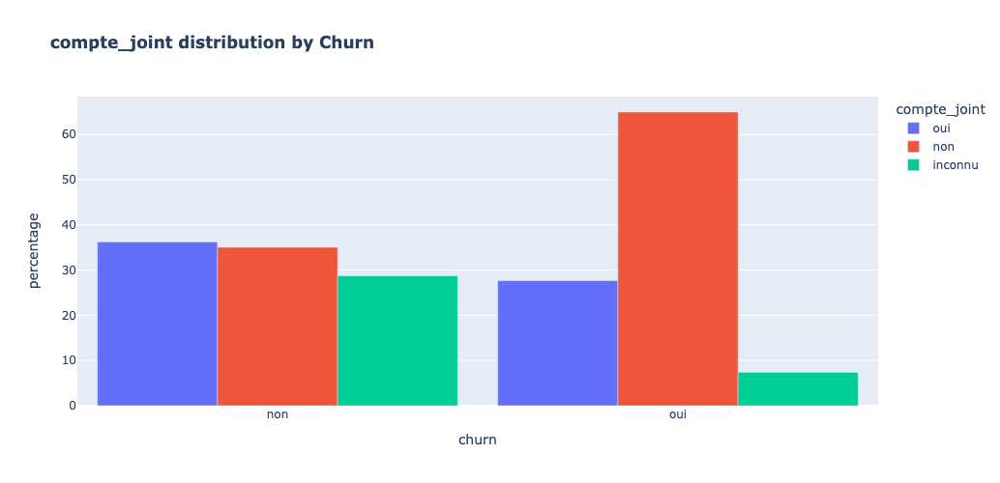

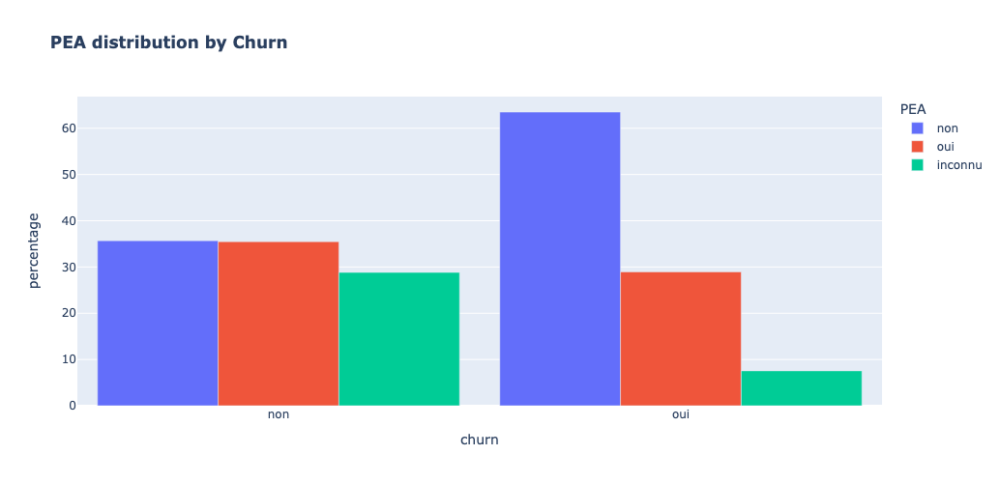

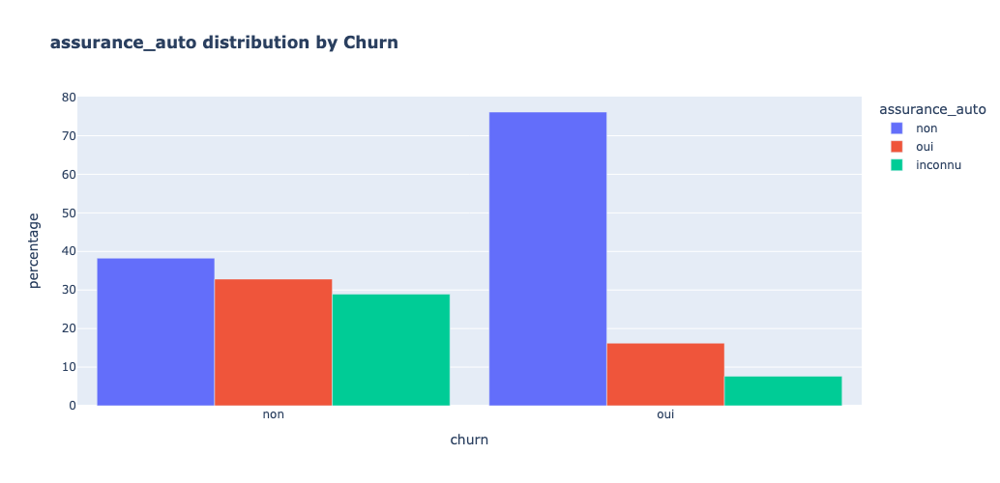

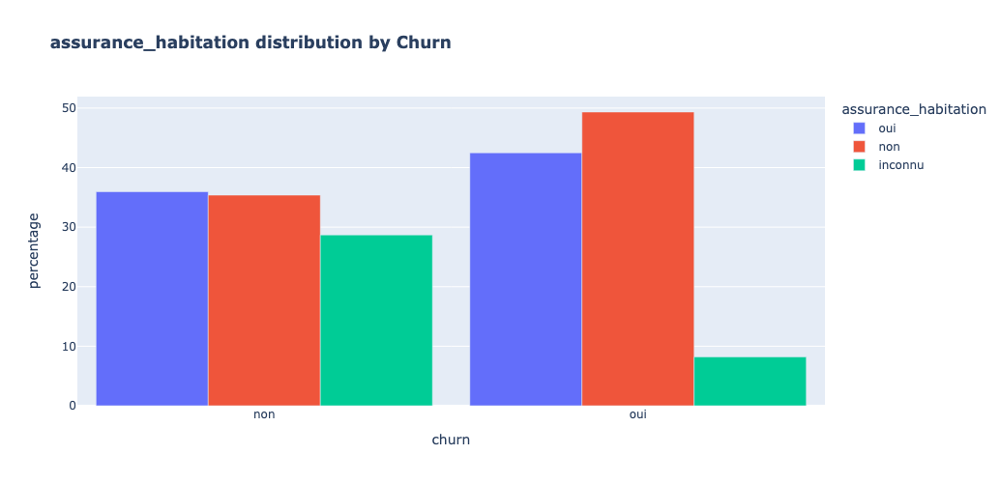

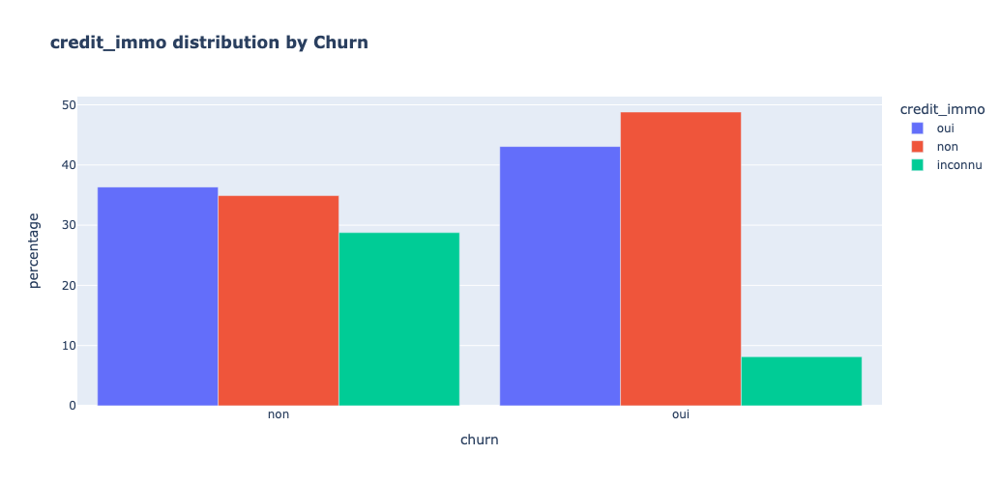

In [30]:
for i in list_column_inco:
    if i!="churn":
        
    # Calculer le pourcentage
        df_grouped = data.groupby("churn")[i].value_counts(normalize=True).rename('percentage').reset_index()
        df_grouped['percentage'] *= 100

    # Créer l'histogramme
        fig = px.bar(df_grouped, x="churn", y='percentage', color=i, barmode='group', title=f"<b>{i} distribution by Churn</b>")
        fig.update_layout(width=700, height=500, bargap=0.1)
        fig.show()

### Ajout des variables manquantes pour les variables type et pour espace_client_web

Pour la variable type on a 27 % de données ayant null , par consequent on ne peut pas directement supprimer les valeurs nulles , une technique peut etre utilisé dans notre cas, c'est dajouter une autre categorie , car peut etre ce client a double compte c'est un compte perso et un compte pro dans cette banque.
Il en a des variables 

In [31]:
data["type"]= data["type"].fillna("categorie 3")

In [32]:
data["espace_client_web"]= data["type"].fillna("-1")

In [33]:
remaining_columns=[]
for i in columns_with_missing_values: 
    if i != "type" and i not in list_column_inco :
        remaining_columns.append(i)

In [34]:
columns_to_modify=['assurance_vie','banque_principale','methode_contact','branche',"cartes_bancaires","compte_epargne","compte_titres","credit_autres"]

In [35]:
for i in columns_to_modify:
    data[i] = data[i].fillna("inconnu")

In [36]:
rest_columns=[i for i in remaining_columns if i not in columns_to_modify]

### Ajout des données manquantes pour colonne age

In [37]:
corelation_numerique["age"].sort_values(ascending=False)

age                             1.000000
anciennete_mois                 0.115301
var_0                           0.101858
var_1                           0.095678
var_2                           0.087549
var_21                          0.085973
var_3                           0.085600
var_25                          0.084244
var_24                          0.083784
var_5                           0.082395
var_20                          0.081767
var_7                           0.081089
var_23                          0.080853
var_4                           0.080708
var_22                          0.079547
var_28                          0.079527
var_6                           0.077141
var_8                           0.076350
var_27                          0.074160
var_26                          0.073238
var_29                          0.071155
var_10                          0.069980
interet_compte_epargne_total    0.069408
var_9                           0.067795
var_11          

Pour Manipuler les données manquantes pour colonne age , on va remplacer ses valeurs manquantes par le mean pour chaque categorie pour ne pas biaser le modele .

In [38]:
# Calculer la médiane d'âge pour les clients avec churn 'oui' et 'non'
age_median_churn_oui = data.loc[data['churn'] == 'oui', 'age'].median()
age_median_churn_non = data.loc[data['churn'] == 'non', 'age'].median()

# Fonction pour remplacer les valeurs manquantes par la médiane correspondante
def impute_age(row):
    if pd.isna(row['age']):
        return age_median_churn_oui if row['churn'] == 'oui' else age_median_churn_non
    else:
        return row['age']

# Application de la fonction pour l'imputation
data['age'] = data.apply(impute_age, axis=1)

### Manipulation des données manquantes pour colonne anciennete mois

In [39]:
corelation_numerique["anciennete_mois"].sort_values(ascending=False)

anciennete_mois                 1.000000
interet_compte_epargne_total    0.825694
agios_6mois                     0.248049
age                             0.115301
var_0                           0.094931
var_1                           0.091862
var_20                          0.090409
var_21                          0.088984
var_2                           0.083233
var_4                           0.081813
var_3                           0.080782
var_27                          0.080263
var_7                           0.079932
var_25                          0.079029
var_29                          0.078645
var_22                          0.078510
var_23                          0.078097
var_5                           0.078020
var_28                          0.076962
var_24                          0.076251
var_6                           0.074257
var_9                           0.073790
var_8                           0.073557
var_32                          0.070477
var_10          

On remarque une forte coorelation entre la variable anciennté mois et la variable interet compte epargne total et ceci est logique puisque plus l'interet epargne totale est eleveé plus l'ancienté de client est elevée.

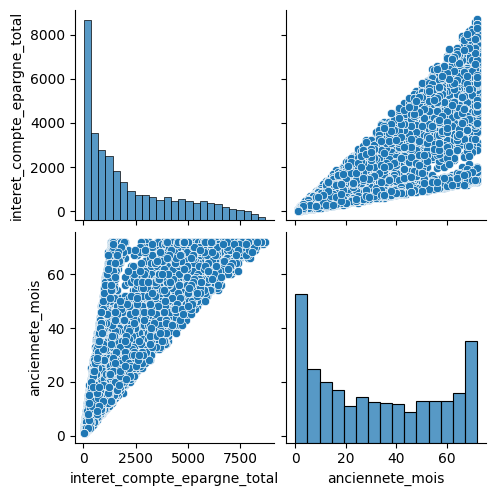

In [40]:
sns.pairplot(data[["interet_compte_epargne_total","anciennete_mois"]])

In [41]:
condition = data['interet_compte_epargne_total'].isnull() & data['anciennete_mois'].isnull()

# Supprimer ces lignes
data = data[~condition]

In [42]:
# Préparation des données pour la régression
data_with_values = data.dropna(subset=['anciennete_mois', 'interet_compte_epargne_total'])
X = data_with_values[['interet_compte_epargne_total']]
y = data_with_values['anciennete_mois']

# Construction du modèle d'arbre de décision
model = DecisionTreeRegressor()
model.fit(X, y)

# Prédiction des valeurs manquantes
data_missing = data[data['anciennete_mois'].isnull()]
predicted_anciennete = model.predict(data_missing[['interet_compte_epargne_total']])

# Remplacement des valeurs manquantes
data.loc[data['anciennete_mois'].isnull(), 'anciennete_mois'] = predicted_anciennete

### Manipulation des données manquantes pour colonne interet_compte_epargne_total

In [43]:
corelation_numerique["interet_compte_epargne_total"].sort_values(ascending=False)

interet_compte_epargne_total    1.000000
anciennete_mois                 0.825694
agios_6mois                     0.653055
age                             0.069408
var_0                           0.055622
var_21                          0.053487
var_1                           0.051730
var_20                          0.051127
var_27                          0.044816
var_22                          0.044797
var_23                          0.043307
var_28                          0.041881
var_25                          0.041724
var_2                           0.041266
var_4                           0.040739
var_29                          0.040507
var_7                           0.039493
var_3                           0.039135
var_24                          0.038640
var_5                           0.035643
var_8                           0.035588
var_9                           0.035517
var_6                           0.033036
var_30                          0.031564
var_26          

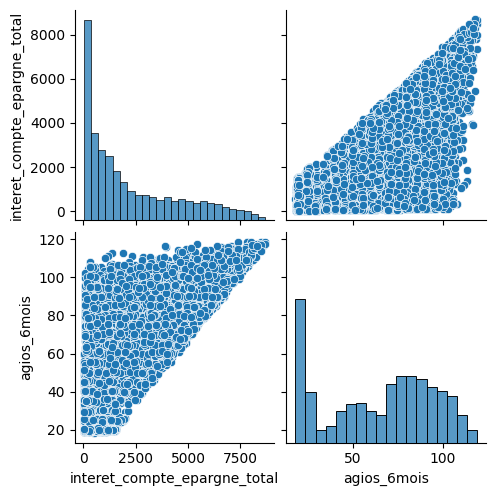

In [44]:
sns.pairplot(data[["interet_compte_epargne_total","agios_6mois"]])

Pour Manipuler les données manquantes des interet_compte_epargne on va utiliser 3 variables les agios_6mois,la variable compte eparnge, et finalement la variable ancienneté, on va construire une decesion Tree pour imputer les variables manquantes de interet_compte_epargne

#### Enlever les varaibles manquantes entre agios_6mois et interet_compte epargne

In [45]:
condition = data['interet_compte_epargne_total'].isnull() & data['agios_6mois'].isnull()

# Supprimer ces lignes
data = data[~condition]

#### Remplacer les variables manquantes de compte epargne par inconnue 

In [46]:
data["compte_epargne"]=data["compte_epargne"].fillna("inconnu")

#### Creer la Decesion Tree pour remplacer les valeurs manquantes dans interet_compte_epargne 

In [47]:
# Préparation des données pour la régression
data_with_values = data.dropna(subset=['anciennete_mois', 'interet_compte_epargne_total',"agios_6mois"])
X = data_with_values[['compte_epargne','anciennete_mois',"agios_6mois"]]
y = data_with_values['interet_compte_epargne_total']

# Construction du modèle d'arbre de décision
model = CatBoostRegressor(cat_features=["compte_epargne"],verbose=0)
model.fit(X, y)

# Prédiction des valeurs manquantes
data_missing = data[data['interet_compte_epargne_total'].isnull()]
predicted_interet = model.predict(data_missing[['compte_epargne','anciennete_mois',"agios_6mois"]])

# Remplacement des valeurs manquantes
data.loc[data['interet_compte_epargne_total'].isnull(), 'interet_compte_epargne_total'] = predicted_interet

### Manipulation des données manquantes pour colonne agios_6mois

In [48]:
corelation_numerique["agios_6mois"].sort_values(ascending=False)

agios_6mois                     1.000000
interet_compte_epargne_total    0.653055
anciennete_mois                 0.248049
var_33                         -0.027327
var_32                         -0.029636
var_18                         -0.031098
var_29                         -0.032184
var_36                         -0.032237
var_35                         -0.032788
var_22                         -0.032895
var_19                         -0.033355
var_17                         -0.033399
var_38                         -0.033437
var_34                         -0.033761
var_23                         -0.033929
var_30                         -0.034502
var_37                         -0.034894
var_25                         -0.034898
var_21                         -0.035081
var_12                         -0.035133
var_26                         -0.035221
var_24                         -0.035265
var_9                          -0.035311
var_11                         -0.035539
var_8           

In [49]:
# Préparation des données pour la régression
data_with_values = data.dropna(subset=["agios_6mois",'anciennete_mois', 'interet_compte_epargne_total'])
X = data_with_values[["agios_6mois", 'interet_compte_epargne_total']]
y = data_with_values['agios_6mois']

# Construction du modèle d'arbre de décision
model = DecisionTreeRegressor()
model.fit(X, y)

# Prédiction des valeurs manquantes
data_missing = data[data['agios_6mois'].isnull()]
predicted_agios = model.predict(data_missing[["agios_6mois",'interet_compte_epargne_total']])

# Remplacement des valeurs manquantes
data.loc[data['agios_6mois'].isnull(), 'agios_6mois'] = predicted_agios

### Manipulation des données var_0

On remarque que la variable 0 est hautement correlé par var 1 d'ou on peut remplir les variables de var0 par les elements de var 1

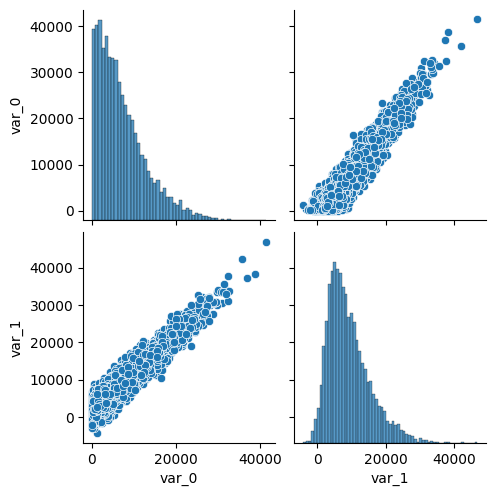

In [50]:
sns.pairplot(data[["var_0","var_1"]])

In [51]:
condition = data['var_0'].isnull() & data['var_1'].isnull()

# Supprimer ces lignes
data = data[~condition]

In [52]:
# Préparation des données pour la régression
data_with_values = data.dropna(subset=['var_0', 'var_1'])
X = data_with_values[['var_1']]
y = data_with_values['var_0']

# Construction du modèle de régression
model = LinearRegression()
model.fit(X, y)

# Prédiction des valeurs manquantes
data_missing = data[data['var_0'].isnull()]
predicted_var = model.predict(data_missing[['var_1']])

# Remplacement des valeurs manquantes
data.loc[data['var_0'].isnull(), 'var_0'] = predicted_var

On remarque d'apres la matrice de coorelation et meme par les plots que les variables inconnues sont hautement cooreles , par consequent si on part d'une var0 on peut obtenir toutes les autres var, en terme de coorelation cette variable est la plus correlé avec churn , par consequent on va utiliser que cette variable dans note 1 ere modelisation et on va la tester puis voir si on peut ajouter d'autres variables .

### Modification de la colonne segment_client

In [53]:
data[data['segment_client'].isna()]["churn"].value_counts(normalize=True)

churn
non    0.770701
oui    0.229299
Name: proportion, dtype: float64

In [54]:
# Définir les segments à fusionner en 'Churn_Élevé'
segments_churn_eleve = ['A2', 'A3', 'B3', 'B4', 'D2', 'D3']

# Appliquer la fusion
data['segment_client'] = data['segment_client'].apply(lambda x: 'Autres_Segments' if x in segments_churn_eleve else x)

In [55]:
data["segment_client"].value_counts(normalize=True)

segment_client
Autres_Segments    0.108041
B2                 0.104697
A1                 0.103388
D1                 0.103243
C1                 0.102952
B1                 0.098880
C4                 0.098008
C2                 0.094373
A4                 0.093791
C3                 0.092628
Name: proportion, dtype: float64

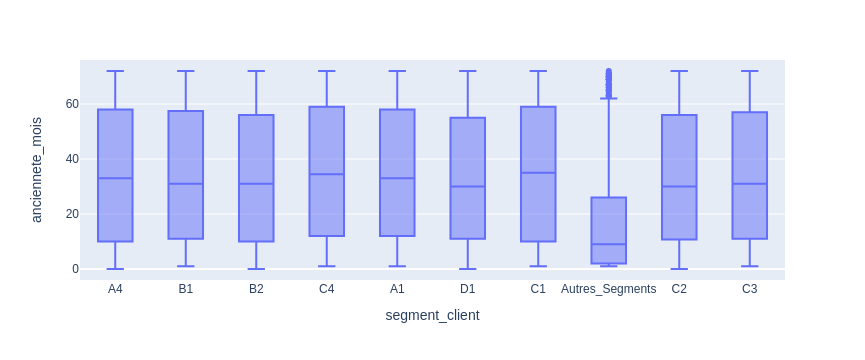

In [56]:
px.box(data[["segment_client","anciennete_mois"]],x="segment_client",y="anciennete_mois")

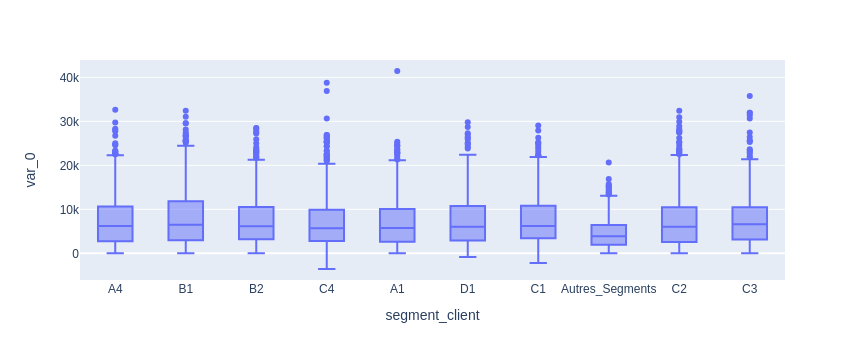

In [57]:
px.box(data[["segment_client","var_0"]],x="segment_client",y="var_0")

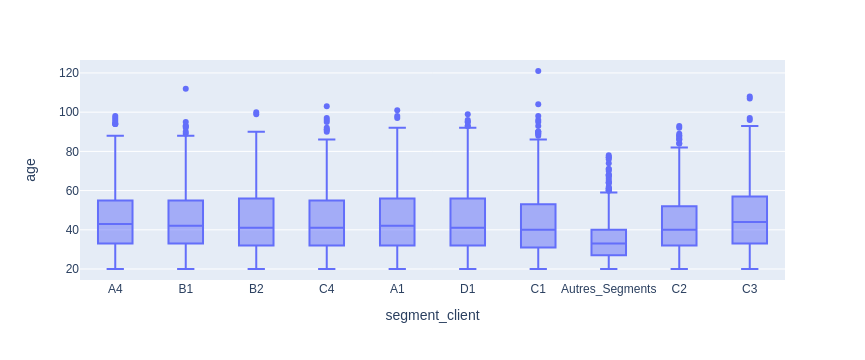

In [58]:
px.box(data[["segment_client","age"]],x="segment_client",y="age")

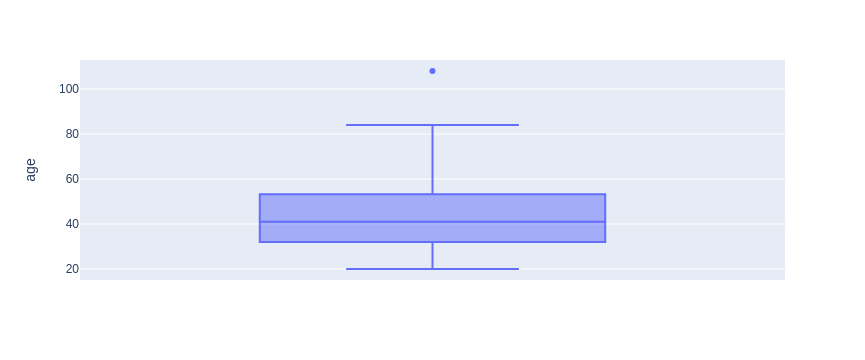

In [59]:
px.box(data[data["segment_client"].isna()],y="age")

In [60]:
data["segment_client"]=data["segment_client"].fillna("Autres_Segments")

In [61]:
data.groupby("segment_client")["churn"].value_counts(normalize=True)

segment_client   churn
A1               non      0.828411
                 oui      0.171589
A4               non      0.809302
                 oui      0.190698
Autres_Segments  oui      0.865556
                 non      0.134444
B1               non      0.832353
                 oui      0.167647
B2               non      0.829167
                 oui      0.170833
C1               non      0.824859
                 oui      0.175141
C2               non      0.818182
                 oui      0.181818
C3               non      0.833595
                 oui      0.166405
C4               non      0.817507
                 oui      0.182493
D1               non      0.808451
                 oui      0.191549
Name: proportion, dtype: float64

### Suppression des colonnes unecessaires

On a remarqué que ce soit d'apres la matrice de correltion et meme en voyant l'interaction de certains variables avec la variable churn qu'on peut supprimer certaines colonnes qui ne vont pas  affecter notre modelisation.

##### Suppression des données categoriques unecessaires

In [62]:
colonnes_a_supprime=["genre","compte_epargne",'credit_autres']

In [63]:
data=data.drop(colonnes_a_supprime,axis=1)

##### Suppression des données continue unecessaires

In [64]:
colonnes_continues_a_supprime=['var_1', 'var_2', 'var_3', 'var_4', 'var_5', 'var_6', 'var_7',
       'var_8', 'var_9', 'var_10', 'var_11', 'var_12', 'var_13', 'var_14',
       'var_15', 'var_16', 'var_17', 'var_18', 'var_19', 'var_20', 'var_21',
       'var_22', 'var_23', 'var_24', 'var_25', 'var_26', 'var_27', 'var_28',
       'var_29', 'var_30', 'var_31', 'var_32', 'var_33', 'var_34', 'var_35',
       'var_36', 'var_37', 'var_38']

In [65]:
data=data.drop(colonnes_continues_a_supprime,axis=1)

## Preparation des données pour l'entrainement 

### Diviser notre données a des données de Test et d'entrainement 

In [66]:
Y=data["churn"]
X=data.drop("churn",axis=1)

In [67]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

### Preparation des données Continues

In [68]:
X_train.isna().sum()

espace_client_web               0
assurance_vie                   0
banque_principale               0
anciennete_mois                 0
cartes_bancaires                0
compte_courant                  0
compte_joint                    0
PEA                             0
assurance_auto                  0
assurance_habitation            0
credit_immo                     0
type                            0
compte_titres                   0
methode_contact                 0
agios_6mois                     0
interet_compte_epargne_total    0
age                             0
segment_client                  0
var_0                           0
branche                         0
dtype: int64

## Modélisation

### Premiere modelisation avec Catboost

In [69]:
cat_features=[i for i in object_columns if i in X_train.columns]

In [70]:
# Initialize CatBoostClassifier with required parameters
catboost_model = CatBoostClassifier(
            iterations=1000,
            depth=6,
            learning_rate=0.01,
            loss_function='Logloss',
            od_type='Iter',
            od_wait=10,
            use_best_model=True,
            verbose=False,auto_class_weights="Balanced",cat_features=cat_features
        )

In [71]:
# Initialize StratifiedKFold
def training_model_with_StratifiedCv(n_splits,model):
    kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    
    # List to store the balanced accuracy scores
    balanced_accuracy_scores = []
    X_train.reset_index(drop=True, inplace=True)
    y_train.reset_index(drop=True, inplace=True)
    
    for train_index, val_index in kf.split(X_train, y_train):
        X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
        y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]
    

    
        # Fit the model
        model.fit(X_train_cv, y_train_cv, eval_set=(X_val, y_val))
    
        # Predict on the test set
        predictions = model.predict(X_val)
    
        # Calculate balanced accuracy score
        score = balanced_accuracy_score(y_val, predictions)
        balanced_accuracy_scores.append(score)
    return balanced_accuracy_scores

In [72]:
balanced_accuracy_scores_catboost_without_scaling=training_model_with_StratifiedCv(5,catboost_model)

In [73]:
y_predict_catboost_without_scaling=catboost_model.predict(X_test)

In [74]:
y_predict_proba__without_scaling=catboost_model.predict_proba(X_test)[:,1]

In [75]:
roc_auc_score_catboost_without_scaling=roc_auc_score(y_test, y_predict_proba__without_scaling)

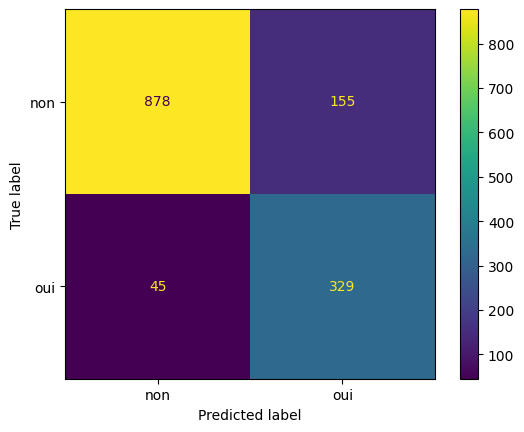

In [78]:
ConfusionMatrixDisplay.from_predictions(y_test, y_predict_catboost_without_scaling)

In [79]:
balanced_acc_without_scaling=balanced_accuracy_score(y_predict_catboost_without_scaling,y_test)

In [80]:
sensitivity_catboost_without_scaling= sensitivity_score(
    y_test, y_predict_catboost_without_scaling, pos_label='oui')
specificity_caboost_without_scaling= specificity_score(
   y_test, y_predict_catboost_without_scaling, pos_label='oui')

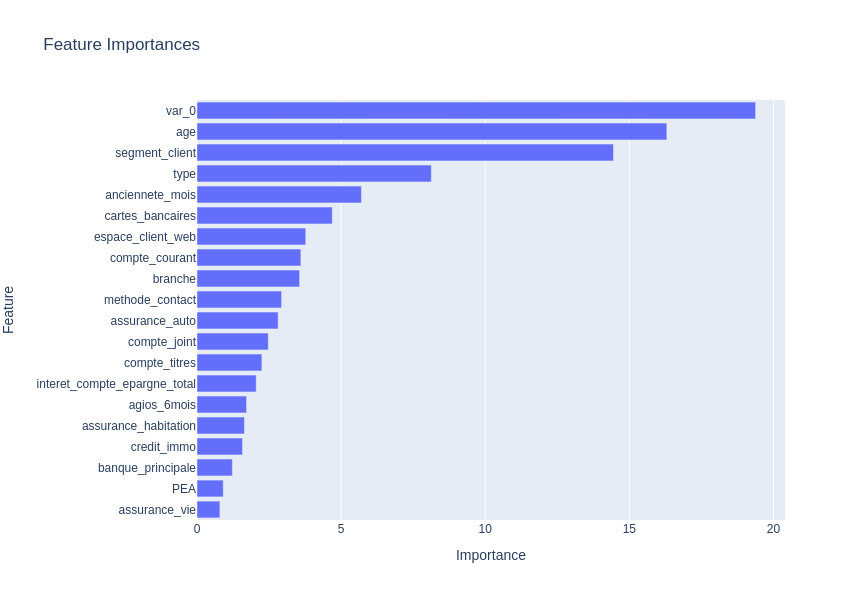

In [81]:
importance = pd.Series(
    catboost_model.feature_importances_,
    index=X_train.columns
).sort_values()
feature_importances = catboost_model.get_feature_importance()
feature_names = X.columns
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importance_df=importance_df.sort_values(by="Importance",ascending=True)
fig = px.bar(importance_df, x='Importance', y='Feature', orientation='h',
             title='Feature Importances')
fig.update_layout(autosize=False, width=800, height=600)
fig.show()

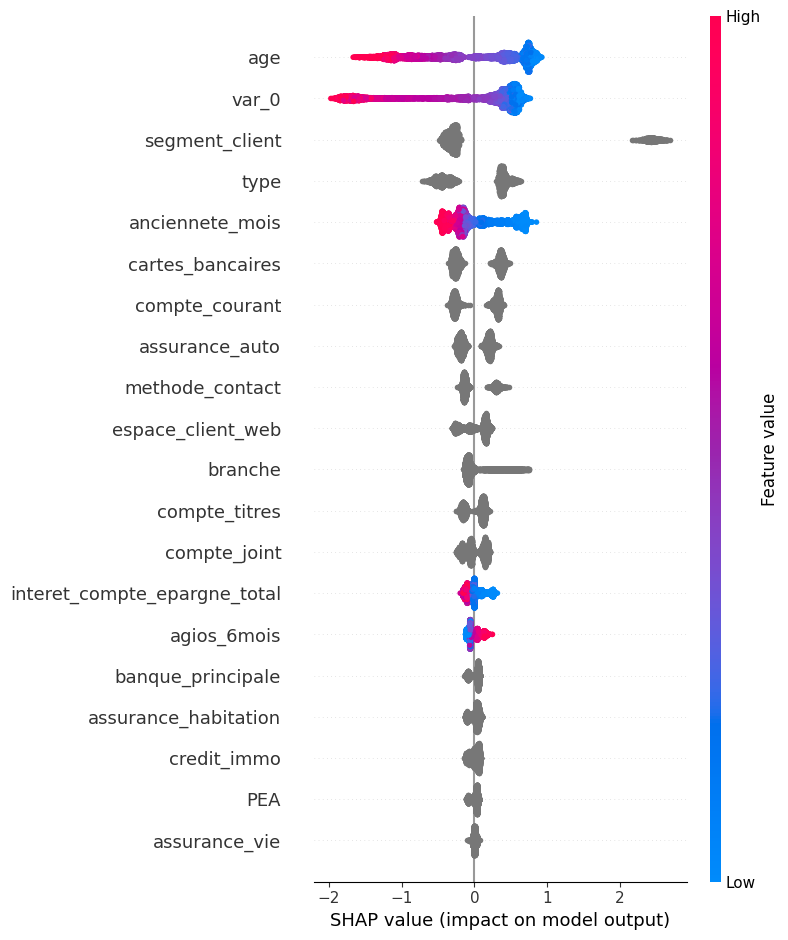

In [82]:

# Create object that can calculate shap values
explainer = shap.TreeExplainer(catboost_model)

# Calculate Shap values
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values, X, feature_names=X.columns)

### Catboost avec Stander Scalling 

Dans cette nouvelle approche on va scaler les parametres numeriques par Robust Scalar puisqu'on a des valeurs aberantes dans certains variables numeriques.

In [83]:
cont_var_cat = [i for i in continuous_var if i in X_train.columns]

In [84]:
scaler = RobustScaler()
# Applying RobustScaler
X_train[cont_var_cat] = scaler.fit_transform(X_train[cont_var_cat])

In [85]:
# Initialize CatBoostClassifier with required parameters
catboost_model_with_scale = CatBoostClassifier(
        iterations=1000,
        depth=6,
        learning_rate=0.01,
        loss_function='Logloss',
        od_type='Iter',
        od_wait=10,
        use_best_model=True,
        verbose=False,auto_class_weights="Balanced",cat_features=cat_features
    )


In [86]:
balanced_accuracy_scores_catboost_with_scaling=training_model_with_StratifiedCv(5,catboost_model_with_scale)

In [87]:
balanced_accuracy_scores_catboost_with_scaling

[0.8307801498748347,
 0.8353722403982642,
 0.8549682283339961,
 0.8733571145140784,
 0.8658057123421898]

In [88]:
X_test[cont_var_cat] = scaler.fit_transform(X_test[cont_var_cat])

In [89]:
y_predict_with_scaling=catboost_model_with_scale.predict(X_test)

In [90]:
y_predict_proba__with_scaling=catboost_model_with_scale.predict_proba(X_test)[:,1]

In [91]:
roc_auc_score_catboost_with_scaling=roc_auc_score(y_test, y_predict_proba__with_scaling)

In [92]:
balanced_acc_with_scaling=balanced_accuracy_score(y_predict_with_scaling,y_test)

In [93]:
sensitivity_catboost_with_scaling= sensitivity_score(
    y_test, y_predict_with_scaling, pos_label='oui')
specificity_caboost_with_scaling= specificity_score(
   y_test, y_predict_with_scaling, pos_label='oui')

#### Benchmarking entre catboost with scaling and without scaling 

In [94]:
data_benchmark = {"model": ["catboost_without_scaling","catboost_with_scaling"],
"Accuracy": [balanced_acc_without_scaling,balanced_acc_with_scaling],
"AUC score": [roc_auc_score_catboost_without_scaling,roc_auc_score_catboost_with_scaling],
"Sensitivity":[sensitivity_catboost_without_scaling,sensitivity_catboost_with_scaling],
"Specifity":[specificity_caboost_without_scaling,specificity_caboost_with_scaling]}
df_benchmark = pd.DataFrame(data_benchmark, columns=['model','Accuracy','AUC score',"Sensitivity","Specifity"])

In [95]:
df_benchmark

,model,Accuracy,AUC score,Sensitivity,Specifity
0,catboost_without_scaling,0.815499,0.945649,0.879679,0.849952
1,catboost_with_scaling,0.815619,0.945201,0.882353,0.848984


### Utilisation de Modele BalancedRnadomForest

#### Traitement de données necessaires

In [96]:
# Création du préprocesseur
preprocessor_rf = ColumnTransformer([
    ('one-hot-encoder', OneHotEncoder(handle_unknown='ignore'), cat_features),
    ('robust-scaler', RobustScaler(), cont_var_cat)
])

# Supposons que X est votre DataFrame
X_transformed = preprocessor_rf.fit_transform(X)

# X_transformed est maintenant un array numpy. Si vous voulez le convertir en DataFrame :
columns_transformed = (preprocessor_rf.named_transformers_['one-hot-encoder'].get_feature_names_out(cat_features).tolist() 
                       + cont_var_cat)
X_transformed_df = pd.DataFrame(X_transformed, columns=columns_transformed)

In [97]:
label_encoder = LabelEncoder()
Y_encoded = pd.Series(label_encoder.fit_transform(Y))

In [98]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed_df, Y_encoded, test_size=0.2, stratify=Y, random_state=42)

In [99]:
# Création du modèle
brf_model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)

In [100]:
n_splits=5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# List to store the balanced accuracy scores
balanced_accuracy_scores = []
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
for train_index, val_index in kf.split(X_train, y_train):
    X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]



    # Fit the model
    brf_model.fit(X_train_cv, y_train_cv)

    # Predict on the test set
    predictions = brf_model.predict(X_val)

    # Calculate balanced accuracy score
    score = balanced_accuracy_score(y_val, predictions)
    balanced_accuracy_scores.append(score)

In [101]:
np.mean(balanced_accuracy_scores)

0.8383415913341021

In [102]:
Y_encoded.value_counts()

0    5166
1    1868
Name: count, dtype: int64

In [103]:
y_predict_with_balanced_rf=brf_model.predict(X_test)
y_predict_proba__with_balanced_rf=brf_model.predict_proba(X_test)[:,1]

In [104]:
roc_auc_score_catboost_with_balanced_rf=roc_auc_score(y_test, y_predict_proba__with_balanced_rf)
balanced_acc_with_balanced_rf=balanced_accuracy_score(y_predict_with_balanced_rf,y_test)
sensitivity_catboost_with_balanced_rf= sensitivity_score(
    y_test, y_predict_with_balanced_rf, pos_label=1)
specificity_caboost_with_balanced_rf= specificity_score(
   y_test, y_predict_with_balanced_rf, pos_label=1)

In [107]:
df_benchmark.loc[len(df_benchmark)] = ["BRF", balanced_acc_with_balanced_rf,roc_auc_score_catboost_with_balanced_rf,sensitivity_catboost_with_balanced_rf,specificity_caboost_with_balanced_rf]

In [108]:
df_benchmark

,model,Accuracy,AUC score,Sensitivity,Specifity
0,catboost_without_scaling,0.815499,0.945649,0.879679,0.849952
1,catboost_with_scaling,0.815619,0.945201,0.882353,0.848984
2,BRF,0.804915,0.934539,0.868984,0.840271


#### Utilisation de modele de Logistic Regression

In [109]:
model_logistic = LogisticRegression(class_weight="balanced")

In [110]:
n_splits=5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# List to store the balanced accuracy scores
balanced_accuracy_scores = []
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
for train_index, val_index in kf.split(X_train, y_train):
    X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]



    # Fit the model
    model_logistic.fit(X_train_cv, y_train_cv)

    # Predict on the test set
    predictions = model_logistic.predict(X_val)

    # Calculate balanced accuracy score
    score = balanced_accuracy_score(y_val, predictions)
    balanced_accuracy_scores.append(score)

In [111]:
np.mean(balanced_accuracy_scores)

0.8445112048068519

In [112]:
y_predict_with_balanced_lr=model_logistic.predict(X_test)
y_predict_proba__with_balanced_lr=model_logistic.predict_proba(X_test)[:,1]

In [113]:
roc_auc_score_catboost_with_balanced_lr=roc_auc_score(y_test, y_predict_proba__with_balanced_lr)
balanced_acc_with_balanced_lr=balanced_accuracy_score(y_predict_with_balanced_lr,y_test)
sensitivity_catboost_with_balanced_lr= sensitivity_score(
    y_test, y_predict_with_balanced_lr, pos_label=1)
specificity_caboost_with_balanced_lr= specificity_score(
   y_test, y_predict_with_balanced_lr, pos_label=1)

In [114]:
df_benchmark.loc[len(df_benchmark)] = ["LR", balanced_acc_with_balanced_lr,roc_auc_score_catboost_with_balanced_lr,sensitivity_catboost_with_balanced_lr,specificity_caboost_with_balanced_lr]

In [115]:
df_benchmark

,model,Accuracy,AUC score,Sensitivity,Specifity
0,catboost_without_scaling,0.815499,0.945649,0.879679,0.849952
1,catboost_with_scaling,0.815619,0.945201,0.882353,0.848984
2,BRF,0.804915,0.934539,0.868984,0.840271
3,LR,0.820505,0.940617,0.874332,0.858664


#### Utilisation de modele de Gradient_boosting

In [116]:
scale_pos_weight=sum(Y=="non")/sum(Y=="oui")

In [117]:
model_xgboost = XGBClassifier(n_iterations=1000,learning_rate=0.01,early_stopping_rounds=10,scale_pos_weight=scale_pos_weight)

In [118]:
# Initialize StratifiedKFold
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    
# List to store the balanced accuracy scores
balanced_accuracy_scores = []
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)

for train_index, val_index in kf.split(X_train, y_train):
    X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]



    # Fit the model
    model_xgboost.fit(X_train_cv, y_train_cv, eval_set=[(X_val, y_val)],verbose=False)

    # Predict on the test set
    predictions = model_xgboost.predict(X_val)

    # Calculate balanced accuracy score
    score = balanced_accuracy_score(y_val, predictions)
    balanced_accuracy_scores.append(score)

In [119]:
balanced_accuracy_scores

[0.8231650847443919,
 0.8235634298932759,
 0.8343653376398886,
 0.8502635904994048,
 0.8454513430563542]

In [120]:
np.mean(balanced_accuracy_scores)

0.8353617571666632

In [121]:
y_predict_with_balanced_xgboost=model_xgboost.predict(X_test)
y_predict_proba__with_balanced_xgboost=model_xgboost.predict_proba(X_test)[:,1]

In [122]:
roc_auc_score_with_balanced_xgboost=roc_auc_score(y_test, y_predict_proba__with_balanced_xgboost)
balanced_acc_with_balanced_xgboost=balanced_accuracy_score(y_predict_with_balanced_xgboost,y_test)
sensitivity_catboost_with_balanced_xgboost= sensitivity_score(
    y_test, y_predict_with_balanced_xgboost, pos_label=1)
specificity_caboost_with_balanced_xgboost= specificity_score(
   y_test, y_predict_with_balanced_xgboost, pos_label=1)

In [125]:
df_benchmark.loc[len(df_benchmark)] = ["Xgboost", balanced_acc_with_balanced_xgboost,roc_auc_score_with_balanced_xgboost,sensitivity_catboost_with_balanced_xgboost,specificity_caboost_with_balanced_xgboost]

In [126]:
df_benchmark

,model,Accuracy,AUC score,Sensitivity,Specifity
0,catboost_without_scaling,0.815499,0.945649,0.879679,0.849952
1,catboost_with_scaling,0.815619,0.945201,0.882353,0.848984
2,BRF,0.804915,0.934539,0.868984,0.840271
3,LR,0.820505,0.940617,0.874332,0.858664
4,Xgboost,0.814588,0.935653,0.852941,0.859632


#### Utilisation de modele de SVM

In [127]:
model_svm = SVC(class_weight='balanced',probability=True)

In [128]:
n_splits=5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# List to store the balanced accuracy scores
balanced_accuracy_scores = []
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
for train_index, val_index in kf.split(X_train, y_train):
    X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]



    # Fit the model
    model_svm.fit(X_train_cv, y_train_cv)

    # Predict on the test set
    predictions = model_svm.predict(X_val)

    # Calculate balanced accuracy score
    score = balanced_accuracy_score(y_val, predictions)
    balanced_accuracy_scores.append(score)

In [129]:
balanced_accuracy_scores

[0.8216343879032486,
 0.8399259118464207,
 0.8422108697239963,
 0.8668118911302405,
 0.8459129301060031]

In [130]:
y_predict_with_balanced_svm=model_svm.predict(X_test)
y_predict_proba__with_balanced_svm=model_svm.predict_proba(X_test)[:,1]

In [131]:
roc_auc_score_with_balanced_svm=roc_auc_score(y_test, y_predict_proba__with_balanced_svm)
balanced_acc_with_balanced_svm=balanced_accuracy_score(y_predict_with_balanced_svm,y_test)
sensitivity_catboost_with_balanced_svm= sensitivity_score(
    y_test, y_predict_with_balanced_svm, pos_label=1)
specificity_caboost_with_balanced_svm= specificity_score(
   y_test, y_predict_with_balanced_svm, pos_label=1)

In [132]:
df_benchmark.loc[len(df_benchmark)] = ["svm", balanced_acc_with_balanced_svm,roc_auc_score_with_balanced_svm,sensitivity_catboost_with_balanced_svm,specificity_caboost_with_balanced_svm]

In [133]:
df_benchmark

,model,Accuracy,AUC score,Sensitivity,Specifity
0,catboost_without_scaling,0.815499,0.945649,0.879679,0.849952
1,catboost_with_scaling,0.815619,0.945201,0.882353,0.848984
2,BRF,0.804915,0.934539,0.868984,0.840271
3,LR,0.820505,0.940617,0.874332,0.858664
4,Xgboost,0.814588,0.935653,0.852941,0.859632
5,svm,0.817240,0.936261,0.866310,0.857696


A ce stade la on a fait un benchmark entre les differents modeles qu'on a utilisé , on a trouvé que les modele catboost ainsi la regression Logistique sont les plus performants , mais en terme d'explicabilité , on sait tous que la regression logistique est plus explicable et ceci en voyant les coeffecients sur les plusieurs variables , Faisant alors la hyperparametrisation de ce modele avant de le valider .

## Hyperparameterisation des parmetres pour le modele logistique regression avec optuna

In [136]:
def objective(trial):
    # Hyperparamètres à optimiser
    C = trial.suggest_loguniform('C', 1e-4, 1e4)
    max_iter = trial.suggest_int('max_iter', 100, 1000)
    solver = trial.suggest_categorical('solver', ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'])

    # Modèle avec les hyperparamètres choisis
    model = LogisticRegression(C=C, max_iter=max_iter, solver=solver,class_weight="balanced")

    # Stratified K-Fold pour la validation croisée
    stratified_kfold = StratifiedKFold(n_splits=5)

    # Score de validation croisée avec balanced accuracy
    scorer = make_scorer(balanced_accuracy_score)
    score = cross_val_score(model, X_train, y_train, n_jobs=-1, cv=stratified_kfold, scoring=scorer)
    return np.mean(score)

# Création de l'étude d'optimisation
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=500)  # Nombre d'itérations d'essai

# Meilleurs paramètres
best_params = study.best_params
print("Meilleurs paramètres:", best_params)

[I 2023-12-19 09:32:51,614] A new study created in memory with name: no-name-d44d307f-24de-4273-8d4e-816c453a0732
[I 2023-12-19 09:32:52,556] Trial 0 finished with value: 0.8434119059999091 and parameters: {'C': 0.10670553309969967, 'max_iter': 425, 'solver': 'sag'}. Best is trial 0 with value: 0.8434119059999091.
[I 2023-12-19 09:32:53,041] Trial 1 finished with value: 0.8412139231389391 and parameters: {'C': 28.24162305058645, 'max_iter': 501, 'solver': 'lbfgs'}. Best is trial 0 with value: 0.8434119059999091.
[I 2023-12-19 09:32:53,522] Trial 2 finished with value: 0.8093357263696819 and parameters: {'C': 0.000827135889167601, 'max_iter': 472, 'solver': 'sag'}. Best is trial 0 with value: 0.8434119059999091.
[I 2023-12-19 09:32:53,678] Trial 3 finished with value: 0.7987379827005816 and parameters: {'C': 0.00038938744064229727, 'max_iter': 422, 'solver': 'sag'}. Best is trial 0 with value: 0.8434119059999091.
[I 2023-12-19 09:32:53,881] Trial 4 finished with value: 0.841093004154658

Meilleurs paramètres: {'C': 0.3490974104314745, 'max_iter': 959, 'solver': 'liblinear'}


In [137]:
model_logistic_opt = LogisticRegression(class_weight="balanced",C= 0.3490974104314745, max_iter=959, solver= 'liblinear')

In [138]:
n_splits=5
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# List to store the balanced accuracy scores
balanced_accuracy_scores = []
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
for train_index, val_index in kf.split(X_train, y_train):
    X_train_cv, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_cv, y_val = y_train.iloc[train_index], y_train.iloc[val_index]



    # Fit the model
    model_logistic_opt.fit(X_train_cv, y_train_cv)

    # Predict on the test set
    predictions = model_logistic_opt.predict(X_val)

    # Calculate balanced accuracy score
    score = balanced_accuracy_score(y_val, predictions)
    balanced_accuracy_scores.append(score)

In [139]:
np.mean(balanced_accuracy_scores)

0.8447531891664353

In [140]:
y_predict_with_balanced_lr_opt=model_logistic_opt.predict(X_test)
y_predict_proba__with_balanced_lr_opt=model_logistic_opt.predict_proba(X_test)[:,1]

In [141]:
roc_auc_score_catboost_with_balanced_lr_opt=roc_auc_score(y_test, y_predict_proba__with_balanced_lr_opt)
balanced_acc_with_balanced_lr_opt=balanced_accuracy_score(y_predict_with_balanced_lr_opt,y_test)
sensitivity_catboost_with_balanced_lr_opt= sensitivity_score(
    y_test, y_predict_with_balanced_lr_opt, pos_label=1)
specificity_caboost_with_balanced_lr= specificity_score(
   y_test, y_predict_with_balanced_lr_opt, pos_label=1)

In [142]:
print(f"roc_auc_socre de model optimal {roc_auc_score_catboost_with_balanced_lr_opt.round(4)}")
print(f"accurancy balanced de model optimal {balanced_acc_with_balanced_lr_opt.round(4)}")
print(f"sensitivity balanced de model optimal {sensitivity_catboost_with_balanced_lr_opt.round(4)}")
print(f"specificity balanced de model optimal {specificity_caboost_with_balanced_lr.round(4)}")

roc_auc_socre de model optimal 0.941
accurancy balanced de model optimal 0.8204
sensitivity balanced de model optimal 0.8717
specificity balanced de model optimal 0.8596


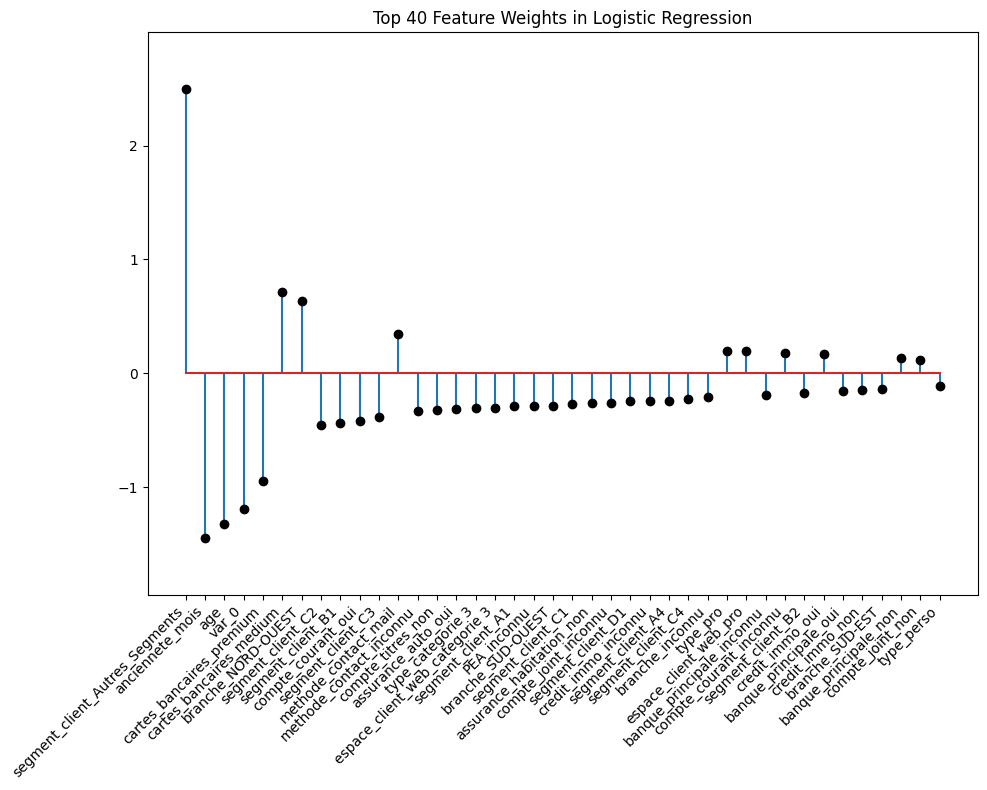

In [145]:
w1 = model_logistic_opt.coef_.flatten()
attributes = X_train.columns.tolist()
# Triez les coefficients par leur importance absolue
sorted_indices = sorted(range(len(w1)), key=lambda k: abs(w1[k]), reverse=True)

# Sélectionnez les indices des 40 caractéristiques les plus importantes
top_40_indices = sorted_indices[:40]

# Créez une liste de valeurs x (index des attributs) et les noms des attributs correspondants
x = [i + 1 for i in range(len(top_40_indices))]
top_attributes = [attributes[i] for i in top_40_indices]
top_weights = [w1[i] for i in top_40_indices]

# Créez votre graphique
fig, ax = plt.subplots(figsize=(10, 8))

# Tracez le stem plot pour les 40 principaux coefficients
markerline, stemlines, baseline = ax.stem(x, top_weights, markerfmt='ko')

# Définissez les propriétés du graphique
ax.set_xticks(x, minor=False)
ax.set_xticklabels(top_attributes, rotation=45, ha="right")
ax.set_ylim(ymin=min(top_weights) - 0.5, ymax=max(top_weights) + 0.5)
ax.set_title("Top 40 Feature Weights in Logistic Regression")

# Affichez le graphique
plt.tight_layout()
plt.show()

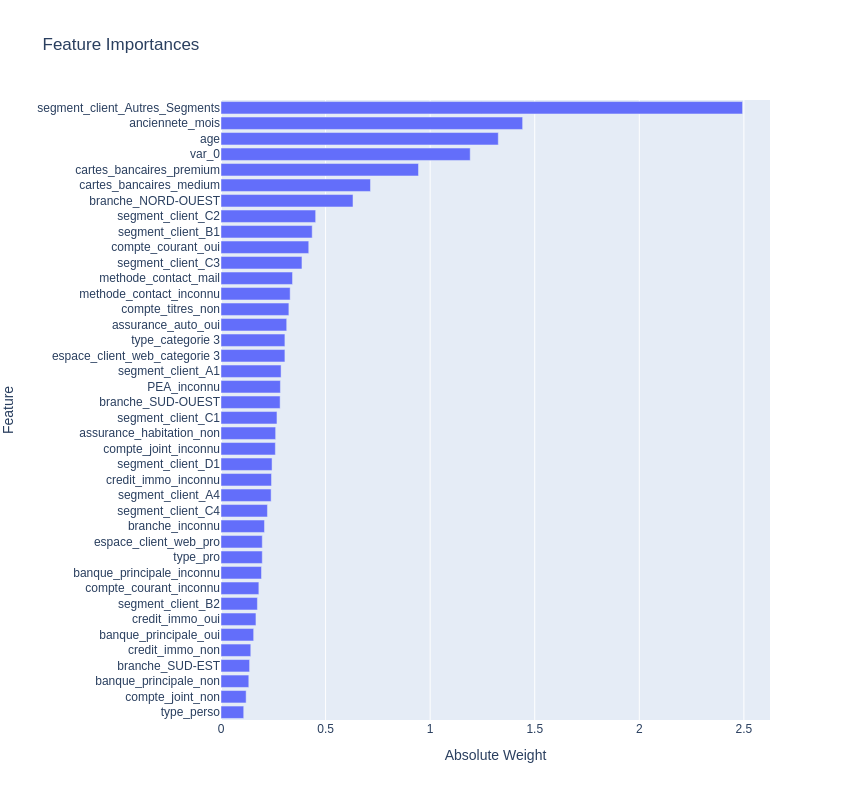

In [146]:
top_weights = [abs(w1[i]) for i in top_40_indices]  # Utiliser la valeur absolue des poids

df_features = pd.DataFrame({'Feature': top_attributes, 'Absolute Weight': top_weights})

# Trier le DataFrame par les poids pour un meilleur affichage
df_features_sorted = df_features.sort_values(by='Absolute Weight', ascending=True)

# Tracer le barplot
fig = px.bar(df_features_sorted, x='Absolute Weight', y='Feature', orientation='h',
             title='Feature Importances')
fig.update_layout(autosize=False, width=900, height=800)
fig.show()

## Sauvegarde de modéle finale

In [151]:
model_info = {
    'model': model_logistic_opt,
    'features': X.columns.tolist()
}

In [152]:
# Sauvegarder le modèle et les features dans un fichier pickle
with open('modele_finale_et_features.pickle', 'wb') as file:
    pickle.dump(model_info, file)